# keras
## keras版本说明
keras官方推荐使用tf.keras, Keras 2.3.0以上版本开始支持TF2

At this time, we recommend that Keras users who use multi-backend Keras with the TensorFlow backend switch to tf.keras in TensorFlow 2.0. tf.keras is better maintained and has better integration with TensorFlow features (eager execution, distribution support and other).

Keras 2.2.5 was the last release of Keras implementing the 2.2.* API. It was the last release to only support TensorFlow 1 (as well as Theano and CNTK).

The current release is Keras 2.3.0, which makes significant API changes and add support for TensorFlow 2.0. The 2.3.0 release will be the last major release of multi-backend Keras. Multi-backend Keras is superseded by tf.keras.

Bugs present in multi-backend Keras will only be fixed until April 2020 (as part of minor releases).
## doc & tf.keras api

https://keras.io/zh/

https://keras.io/

http://keras-cn.readthedocs.io/en/latest/

https://tensorflow.google.cn/api_docs/python/tf/keras

## github
https://github.com/keras-team/keras

https://github.com/keras-team

### 预训练网络 如vgg、seq2seq等
https://github.com/keras-team/keras-applications

## 安装

In [4]:
# !pip install keras -U
!pip freeze | grep Keras

Keras==2.3.1
Keras-Applications==1.0.8
Keras-Preprocessing==1.1.0


### 常见问题centos
>报错信息ImportError: /lib64/libstdc++.so.6: version `CXXABI_1.3.9' not found (required by

    https://blog.csdn.net/ccbrid/article/details/78979878
    添加环境变量：
    LD_LIBRARY_PATH=/~/anaconda3/lib:$LD_LIBRARY_PATH
    export LD_LIBRARY_PATH

# Keras编程
## 编程步骤
### 绘图 绘制network
现在的network都是按层累加的

弄明白官方都内置了哪些层，这些层的效果
#### keras的两种绘图方式
#### The Sequential API: Build a simple model 
#### The Functional API: Build complex models
为了统一起见，后续尽量使用Functional API
### 按照graph给出恰当的input
这样数据就在图流动(flow)起来了

In [5]:
import tensorflow as tf
from tensorflow import keras

In [6]:
print(tf.__version__)

2.1.0


## 示例1: Sequential model
https://tensorflow.google.cn/guide/keras/overview

In [7]:
from tensorflow.keras import layers

### 绘图方式1

In [8]:
model = tf.keras.Sequential()
# Adds a densely-connected layer with 64 units to the model:
model.add(layers.Dense(64, activation='relu'))
# Add another:
model.add(layers.Dense(64, activation='relu'))
# Add a softmax layer with 10 output units:
model.add(layers.Dense(10, activation='softmax'))

### 绘图方式2

In [ ]:
model = tf.keras.Sequential([
# Adds a densely-connected layer with 64 units to the model:
layers.Dense(64, activation='relu', input_shape=(32,)),
# Add another:
layers.Dense(64, activation='relu'),
# Add a softmax layer with 10 output units:
layers.Dense(10, activation='softmax')])

### model.compile

In [10]:
model.compile(optimizer=tf.keras.optimizers.Adam(0.01),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

tf.keras.Model.compile takes three important arguments:

* optimizer: This object specifies the training procedure. Pass it optimizer instances from the tf.keras.optimizers module, such as tf.keras.optimizers.Adam or tf.keras.optimizers.SGD. If you just want to use the default parameters, you can also specify optimizers via strings, such as 'adam' or 'sgd'.
* loss: The function to minimize during optimization. Common choices include mean square error (mse), categorical_crossentropy, and binary_crossentropy. Loss functions are specified by name or by passing a callable object from the tf.keras.losses module.
* metrics: Used to monitor training. These are string names or callables from the tf.keras.metrics module.
* Additionally, to make sure the model trains and evaluates eagerly, you can make sure to pass run_eagerly=True as a parameter to compile.

The following shows a few examples of configuring a model for training:

In [ ]:
# Configure a model for mean-squared error regression.
model.compile(optimizer=tf.keras.optimizers.Adam(0.01),
              loss='mse',       # mean squared error
              metrics=['mae'])  # mean absolute error

# Configure a model for categorical classification.
model.compile(optimizer=tf.keras.optimizers.RMSprop(0.01),
              loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=[tf.keras.metrics.CategoricalAccuracy()])

### Train from different input data source

#### Train from NumPy data

In [11]:
import numpy as np

data = np.random.random((1000, 32))
labels = np.random.random((1000, 10))

model.fit(data, labels, epochs=2, batch_size=32)

Train on 1000 samples
Epoch 1/2
1000/1000 [==============================] - 1s 1ms/sample - loss: 61.8585 - accuracy: 0.0890
Epoch 2/2
1000/1000 [==============================] - 0s 110us/sample - loss: 278.5732 - accuracy: 0.0970


#### using validation_data:

In [12]:
import numpy as np

data = np.random.random((1000, 32))
labels = np.random.random((1000, 10))

val_data = np.random.random((100, 32))
val_labels = np.random.random((100, 10))

model.fit(data, labels, epochs=2, batch_size=32,
          validation_data=(val_data, val_labels))

Train on 1000 samples, validate on 100 samples
Epoch 1/2
1000/1000 [==============================] - 0s 302us/sample - loss: 1150.7458 - accuracy: 0.1160 - val_loss: 1625.4750 - val_accuracy: 0.1400
Epoch 2/2
1000/1000 [==============================] - 0s 187us/sample - loss: 2999.9044 - accuracy: 0.0950 - val_loss: 4113.2799 - val_accuracy: 0.0900


#### Train from tf.data datasets
Use the Datasets API to scale to large datasets or multi-device training. Pass a tf.data.Dataset instance to the fit method:

In [13]:
# Instantiates a toy dataset instance:
dataset = tf.data.Dataset.from_tensor_slices((data, labels))
dataset = dataset.batch(32)

model.fit(dataset, epochs=2)

Train for 32 steps
Epoch 1/2
32/32 [==============================] - 1s 17ms/step - loss: 5890.4119 - accuracy: 0.0830
Epoch 2/2
32/32 [==============================] - 0s 3ms/step - loss: 8204.5054 - accuracy: 0.0880


Datasets can also be used for validation:

In [14]:
dataset = tf.data.Dataset.from_tensor_slices((data, labels))
dataset = dataset.batch(32)

val_dataset = tf.data.Dataset.from_tensor_slices((val_data, val_labels))
val_dataset = val_dataset.batch(32)

model.fit(dataset, epochs=2,
          validation_data=val_dataset)

Train for 32 steps, validate for 4 steps
Epoch 1/2
32/32 [==============================] - 0s 8ms/step - loss: 13983.3608 - accuracy: 0.1010 - val_loss: 21132.5703 - val_accuracy: 0.1100
Epoch 2/2
32/32 [==============================] - 0s 8ms/step - loss: 23282.6366 - accuracy: 0.0950 - val_loss: 33339.5264 - val_accuracy: 0.1200


### Evaluate and predict

In [15]:
# With Numpy arrays
data = np.random.random((10, 32))
labels = np.random.random((10, 10))

model.evaluate(data, labels, batch_size=32)

10/10 [==============================] - 0s 1ms/sample - loss: 35728.6875 - accuracy: 0.0000e+00


[35728.6875, 0.0]

In [16]:
# With a Dataset
dataset = tf.data.Dataset.from_tensor_slices((data, labels))
dataset = dataset.batch(32)

model.evaluate(dataset)

1/1 [==============================] - 0s 3ms/step - loss: 35728.6875 - accuracy: 0.0000e+00


[35728.6875, 0.0]

In [17]:
result = model.predict(data, batch_size=32)
print(result.shape)

(10, 10)


## 示例2: The Functional API
https://tensorflow.google.cn/guide/keras/overview

The tf.keras.Sequential model is a simple stack of layers that cannot represent arbitrary models. Use the Keras functional API to build complex model topologies such as:

* Multi-input models,
* Multi-output models,
* Models with shared layers (the same layer called several times),
* Models with non-sequential data flows (e.g. residual connections).

Building a model with the functional API works like this:

1. A layer instance is callable and returns a tensor.
1. Input tensors and output tensors are used to define a tf.keras.Model instance.
1. This model is trained just like the Sequential model.

In [18]:
inputs = tf.keras.Input(shape=(32,))  # Returns an input placeholder

# A layer instance is callable on a tensor, and returns a tensor.
x = layers.Dense(64, activation='relu')(inputs)
x = layers.Dense(64, activation='relu')(x)
predictions = layers.Dense(10, activation='softmax')(x)

In [19]:
model = tf.keras.Model(inputs=inputs, outputs=predictions)

# The compile step specifies the training configuration.
model.compile(optimizer=tf.keras.optimizers.RMSprop(0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Trains for 5 epochs
model.fit(data, labels, batch_size=32, epochs=2)

Train on 10 samples
Epoch 1/2
10/10 [==============================] - 3s 349ms/sample - loss: 12.7956 - accuracy: 0.1000
Epoch 2/2
10/10 [==============================] - 0s 1ms/sample - loss: 12.7766 - accuracy: 0.1000


### Inception
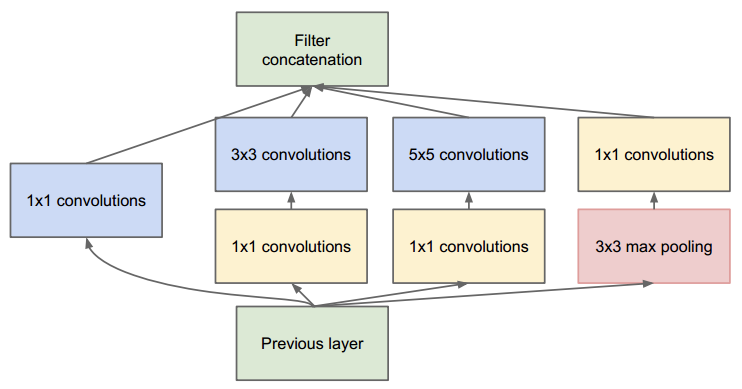

In [ ]:
from keras.layers import Conv2D, MaxPooling2D, Input

input_img = Input(shape=(256, 256, 3))

tower_1 = Conv2D(64, (1, 1), padding='same', activation='relu')(input_img)
tower_1 = Conv2D(64, (3, 3), padding='same', activation='relu')(tower_1)

tower_2 = Conv2D(64, (1, 1), padding='same', activation='relu')(input_img)
tower_2 = Conv2D(64, (5, 5), padding='same', activation='relu')(tower_2)

tower_3 = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(input_img)
tower_3 = Conv2D(64, (1, 1), padding='same', activation='relu')(tower_3)

output = keras.layers.concatenate([tower_1, tower_2, tower_3], axis=1)

## Save and restore

### Save just the weights values
Save and load the weights of a model using tf.keras.Model.save_weights:

In [37]:
model = tf.keras.Sequential([
layers.Dense(64, activation='relu', input_shape=(32,)),
layers.Dense(10, activation='softmax')])

model.compile(optimizer=tf.keras.optimizers.Adam(0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [38]:
# Save weights to a TensorFlow Checkpoint file
model.save_weights('./weights/my_model')

# Restore the model's state,
# this requires a model with the same architecture.
model.load_weights('./weights/my_model')

By default, this saves the model's weights in the TensorFlow checkpoint file format. Weights can also be saved to the Keras HDF5 format (the default for the multi-backend implementation of Keras):

In [39]:
# Save weights to a HDF5 file
model.save_weights('my_model.h5', save_format='h5')

# Restore the model's state
model.load_weights('my_model.h5')

### Save just the model configuration
A model's configuration can be saved—this serializes the model architecture without any weights. A saved configuration can recreate and initialize the same model, even without the code that defined the original model. Keras supports JSON and YAML serialization formats:

In [40]:
# Serialize a model to JSON format
json_string = model.to_json()
json_string

'{"class_name": "Sequential", "config": {"name": "sequential_3", "layers": [{"class_name": "Dense", "config": {"name": "dense_17", "trainable": true, "batch_input_shape": [null, 32], "dtype": "float32", "units": 64, "activation": "relu", "use_bias": true, "kernel_initializer": {"class_name": "GlorotUniform", "config": {"seed": null}}, "bias_initializer": {"class_name": "Zeros", "config": {}}, "kernel_regularizer": null, "bias_regularizer": null, "activity_regularizer": null, "kernel_constraint": null, "bias_constraint": null}}, {"class_name": "Dense", "config": {"name": "dense_18", "trainable": true, "dtype": "float32", "units": 10, "activation": "softmax", "use_bias": true, "kernel_initializer": {"class_name": "GlorotUniform", "config": {"seed": null}}, "bias_initializer": {"class_name": "Zeros", "config": {}}, "kernel_regularizer": null, "bias_regularizer": null, "activity_regularizer": null, "kernel_constraint": null, "bias_constraint": null}}]}, "keras_version": "2.2.4-tf", "backen

In [41]:
import json
import pprint
pprint.pprint(json.loads(json_string))

{'backend': 'tensorflow',
 'class_name': 'Sequential',
 'config': {'layers': [{'class_name': 'Dense',
                        'config': {'activation': 'relu',
                                   'activity_regularizer': None,
                                   'batch_input_shape': [None, 32],
                                   'bias_constraint': None,
                                   'bias_initializer': {'class_name': 'Zeros',
                                                        'config': {}},
                                   'bias_regularizer': None,
                                   'dtype': 'float32',
                                   'kernel_constraint': None,
                                   'kernel_initializer': {'class_name': 'GlorotUniform',
                                                          'config': {'seed': None}},
                                   'kernel_regularizer': None,
                                   'name': 'dense_17',
                            

Recreate the model (newly initialized) from the JSON:

In [42]:
fresh_model = tf.keras.models.model_from_json(json_string)

Serializing a model to YAML format requires that you install pyyaml before you import TensorFlow:

In [43]:
yaml_string = model.to_yaml()
print(yaml_string)

backend: tensorflow
class_name: Sequential
config:
  layers:
  - class_name: Dense
    config:
      activation: relu
      activity_regularizer: null
      batch_input_shape: !!python/tuple
      - null
      - 32
      bias_constraint: null
      bias_initializer:
        class_name: Zeros
        config: {}
      bias_regularizer: null
      dtype: float32
      kernel_constraint: null
      kernel_initializer:
        class_name: GlorotUniform
        config:
          seed: null
      kernel_regularizer: null
      name: dense_17
      trainable: true
      units: 64
      use_bias: true
  - class_name: Dense
    config:
      activation: softmax
      activity_regularizer: null
      bias_constraint: null
      bias_initializer:
        class_name: Zeros
        config: {}
      bias_regularizer: null
      dtype: float32
      kernel_constraint: null
      kernel_initializer:
        class_name: GlorotUniform
        config:
          seed: null
      kernel_regularizer: null
  

Recreate the model from the YAML:

In [44]:
fresh_model = tf.keras.models.model_from_yaml(yaml_string)

/Users/luoyonggui/anaconda3/lib/python3.7/site-packages/tensorflow_core/python/keras/saving/model_config.py:76: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  config = yaml.load(yaml_string)


### Save the entire model in one file
The entire model can be saved to a file that contains the weight values, the model's configuration, and even the optimizer's configuration. This allows you to checkpoint a model and resume training later—from the exact same state—without access to the original code.

In [45]:
# Create a simple model
model = tf.keras.Sequential([
  layers.Dense(10, activation='softmax', input_shape=(32,)),
  layers.Dense(10, activation='softmax')
])
model.compile(optimizer='rmsprop',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.fit(data, labels, batch_size=32, epochs=5)


# Save entire model to a HDF5 file
model.save('my_model.h5')

# Recreate the exact same model, including weights and optimizer.
model = tf.keras.models.load_model('my_model.h5')

Train on 1000 samples
Epoch 1/5
1000/1000 [==============================] - 0s 388us/sample - loss: 11.4263 - accuracy: 0.0950
Epoch 2/5
1000/1000 [==============================] - 0s 49us/sample - loss: 11.4285 - accuracy: 0.1070
Epoch 3/5
1000/1000 [==============================] - 0s 52us/sample - loss: 11.4420 - accuracy: 0.1010
Epoch 4/5
1000/1000 [==============================] - 0s 49us/sample - loss: 11.4604 - accuracy: 0.1000
Epoch 5/5
1000/1000 [==============================] - 0s 49us/sample - loss: 11.4786 - accuracy: 0.0970


# keras高级特性

## using Keras models with custom training loops and tf.GradientTape
https://tensorflow.google.cn/tutorials/quickstart/advanced

## Distribution - - Multiple GPUs
https://tensorflow.google.cn/guide/keras/overview#distribution

tf.keras models can run on multiple GPUs using tf.distribute.Strategy. This API provides distributed training on multiple GPUs with almost no changes to existing code.

## Callbacks
A callback is an object passed to a model to customize and extend its behavior during training. You can write your own custom callback, or use the built-in tf.keras.callbacks
### 自定义callbacks
可以通过继承keras.callbacks.Callback编写自己的回调函数

回调函数的参数：

    on_epoch_begin: 在每个epoch开始时调用
    on_epoch_end: 在每个epoch结束时调用
    on_batch_begin: 在每个batch开始时调用
    on_batch_end: 在每个batch结束时调用
    on_train_begin: 在训练开始时调用
    on_train_end: 在训练结束时调用


In [ ]:
from tensorflow.keras.callbacks import Callback

class LossHistory(tensorflow.keras.callbacks.Callback):
    def __init__(self, epochs, name):
        self.epochs = epochs
        self.name = name

    def on_train_begin(self, logs={}):
        self.losses = []
        print('starttrain')

    def on_epoch_end(self, epoch, logs={}):
        self.losses.append(logs.get('loss'))
        #这个地方要加1
        process = float(epoch+1)/float(self.epochs) *100
        print( self.name + "的训练进度为" + str(process)  + "loss：" + str(logs.get('loss')))

    def on_train_end(self, logs={}):
        print("endtrain")
        print(self.losses[len(self.losses)-1])


### tf.keras.callbacks.ModelCheckpoint:   
Save checkpoints of your model at regular intervals.
### tf.keras.callbacks.LearningRateScheduler:   
Dynamically change the learning rate.
### tf.keras.callbacks.EarlyStopping:   
Interrupt training when validation performance has stopped improving.
### tf.keras.callbacks.TensorBoard:   
Monitor the model's behavior using TensorBoard.

To use a tf.keras.callbacks.Callback, pass it to the model's fit method:

In [36]:
callbacks = [
  tf.keras.callbacks.ModelCheckpoint(
    'model/weights.{epoch:02d}-{val_loss:.2f}.hdf5', monitor='val_loss', verbose=0, save_best_only=False,
    save_weights_only=True, mode='auto', save_freq='epoch'
  ), # model目录要提前创建好，不然会报错
  # Interrupt training if `val_loss` stops improving for over 2 epochs
  tf.keras.callbacks.EarlyStopping(patience=2, monitor='val_loss'),
  # Write TensorBoard logs to `./logs` directory  文件夹不存在时会自动创建
  tf.keras.callbacks.TensorBoard(log_dir='./logs')
]
model.fit(data, labels, batch_size=32, epochs=5, callbacks=callbacks,
          validation_data=(val_data, val_labels))

Train on 1000 samples, validate on 100 samples
Epoch 1/5
1000/1000 [==============================] - 0s 222us/sample - loss: 11.4132 - accuracy: 0.1030 - val_loss: 11.7068 - val_accuracy: 0.0600
Epoch 2/5
1000/1000 [==============================] - 0s 65us/sample - loss: 11.4137 - accuracy: 0.1030 - val_loss: 11.7069 - val_accuracy: 0.0700
Epoch 3/5
1000/1000 [==============================] - 0s 111us/sample - loss: 11.4131 - accuracy: 0.1020 - val_loss: 11.7064 - val_accuracy: 0.0700
Epoch 4/5
1000/1000 [==============================] - 0s 84us/sample - loss: 11.4126 - accuracy: 0.1040 - val_loss: 11.7056 - val_accuracy: 0.0700
Epoch 5/5
1000/1000 [==============================] - 0s 66us/sample - loss: 11.4123 - accuracy: 0.1030 - val_loss: 11.7061 - val_accuracy: 0.0700


# Layers

## tf.keras.layers.Layer
https://tensorflow.google.cn/api_docs/python/tf/keras/layers/Layer

This is the class from which all layers inherit.

In [ ]:
tf.keras.layers.Layer(
    trainable=True, name=None, dtype=None, dynamic=False, **kwargs
)

A layer is a callable object that takes as input one or more tensors and that outputs one or more tensors. 

layer本质上就是一个转换器，把输入的tensor进行运算和shape变化，所以关键就是要搞清楚
输入tensor的shape，和输出tensor的shape！

It involves 
* computation, defined in the `call()` method, 
* and a state (weight variables), defined either in the constructor `__init__()` or in the `build()` method.

Users will just instantiate a layer and then treat it as a callable.

## Configure the layers
* activation:   
Set the activation function for the layer. This parameter is specified by the name of a built-in function or as a callable object.   
By default, no activation is applied.
* kernel_initializer and bias_initializer:   
The initialization schemes that create the layer's weights (kernel and bias). This parameter is a name or a callable object.   
This defaults to the "Glorot uniform" initializer.
* kernel_regularizer and bias_regularizer:   
The regularization schemes that apply the layer's weights (kernel and bias), such as L1 or L2 regularization.   
By default, no regularization is applied.

In [20]:
# Create a sigmoid layer:
layers.Dense(64, activation='sigmoid')
# Or:
layers.Dense(64, activation=tf.keras.activations.sigmoid)

# A linear layer with L1 regularization of factor 0.01 applied to the kernel matrix:
layers.Dense(64, kernel_regularizer=tf.keras.regularizers.l1(0.01))

# A linear layer with L2 regularization of factor 0.01 applied to the bias vector:
layers.Dense(64, bias_regularizer=tf.keras.regularizers.l2(0.01))

# A linear layer with a kernel initialized to a random orthogonal matrix:
layers.Dense(64, kernel_initializer='orthogonal')

# A linear layer with a bias vector initialized to 2.0s:
layers.Dense(64, bias_initializer=tf.keras.initializers.Constant(2.0))

## tf.keras.layers.Concatenate & tf.keras.layers.concatenate
* tf.keras.layers.Concatenate  
Layer that concatenates a list of inputs.

It takes as input a list of tensors, all of the same shape except for the concatenation axis, and returns a single tensor that is the concatenation of all inputs.

* tf.keras.layers.concatenate
Functional interface to the Concatenate layer.

待合并维度相加，其它维度保持不变

In [27]:
import numpy as np
x = np.arange(20).reshape(2, 2, 5)
print(x)

y = np.arange(20, 30).reshape(2, 1, 5)
print(y)

tf.keras.layers.Concatenate(axis=1)([x, y])

[[[ 0  1  2  3  4]
  [ 5  6  7  8  9]]

 [[10 11 12 13 14]
  [15 16 17 18 19]]]
[[[20 21 22 23 24]]

 [[25 26 27 28 29]]]


<tf.Tensor: shape=(2, 3, 5), dtype=int64, numpy=
array([[[ 0,  1,  2,  3,  4],
        [ 5,  6,  7,  8,  9],
        [20, 21, 22, 23, 24]],

       [[10, 11, 12, 13, 14],
        [15, 16, 17, 18, 19],
        [25, 26, 27, 28, 29]]])>

In [30]:
# 等价于
tf.keras.layers.concatenate([x, y], axis=1)

<tf.Tensor: shape=(2, 3, 5), dtype=int64, numpy=
array([[[ 0,  1,  2,  3,  4],
        [ 5,  6,  7,  8,  9],
        [20, 21, 22, 23, 24]],

       [[10, 11, 12, 13, 14],
        [15, 16, 17, 18, 19],
        [25, 26, 27, 28, 29]]])>

In [ ]:
tf.keras.layers.concatenate(
    inputs, axis=-1, **kwargs
)

In [ ]:
tf.keras.layers.concatenate([uid_fc_layer, gender_fc_layer, age_fc_layer, job_fc_layer], 2)

## tf.keras.Input
注意，input_shape会被转换为(None, input_shape), 即第一个维度会加上batch_size(即一个batch里sample数量)

### 为什么要加逗号
因为不加逗号会被python处理为标量

In [17]:
(32,)

(32,)

In [18]:
(32)

32

In [ ]:
tf.keras.Input(
    shape=None, batch_size=None, name=None, dtype=None, sparse=False, tensor=None,
    ragged=False, **kwargs
)

In [12]:
import tensorflow as tf

In [15]:
# this is a logistic regression in Keras
x = tf.keras.Input(shape=(32,))
y = tf.keras.layers.Dense(16, activation='softmax')(x)
model = tf.keras.Model(x, y)

In [16]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 32)]              0         
_________________________________________________________________
dense_1 (Dense)              (None, 16)                528       
Total params: 528
Trainable params: 528
Non-trainable params: 0
_________________________________________________________________


## tf.keras.layers.Embedding
Turns positive integers (indexes) into dense vectors of fixed size.

生成一个shape=(input_dim, output_dim)的矩阵，indexes为矩阵的行号，通过indexes把相应的dense vectors取出来

__This layer can only be used as the first layer in a model.__

输入数组的形状(batch_size, ..., input_dim), 输出再增加一维: (batch_size, ..., input_dim, embed_dim)

In [ ]:
tf.keras.layers.Embedding(
    input_dim, output_dim, embeddings_initializer='uniform',
    embeddings_regularizer=None, activity_regularizer=None,
    embeddings_constraint=None, mask_zero=False, input_length=None, **kwargs
)

In [25]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.Embedding(1000, 64, input_length=10))
# the model will take as input an integer matrix of size (batch, input_length).
# the largest integer (i.e. word index) in the input should be no larger
# than 999 (vocabulary size).
# now model.output_shape == (None, 10, 64), where None is the batch
# dimension.

input_array = np.random.randint(1000, size=(32, 10))

model.compile('rmsprop', 'mse')
output_array = model.predict(input_array)
assert output_array.shape == (32, 10, 64)

In [26]:
input_array.shape

(32, 10)

In [2]:
import tensorflow as tf

In [18]:
inputs = tf.keras.Input(shape=(32,))  # Returns an input placeholder
inputs2 = tf.keras.Input(shape=(16,))  

In [19]:
e = tf.keras.layers.Embedding(1000, 64)

In [23]:
x = e(inputs)
x2 = e(inputs2)
output = tf.keras.layers.concatenate([x, x2], axis=1)
x = tf.keras.layers.Dense(64, activation='relu')(output)
predictions = tf.keras.layers.Dense(10, activation='softmax')(x)
model = tf.keras.Model(inputs=[inputs,inputs2], outputs=predictions)

# The compile step specifies the training configuration.
model.compile(optimizer=tf.keras.optimizers.RMSprop(0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])


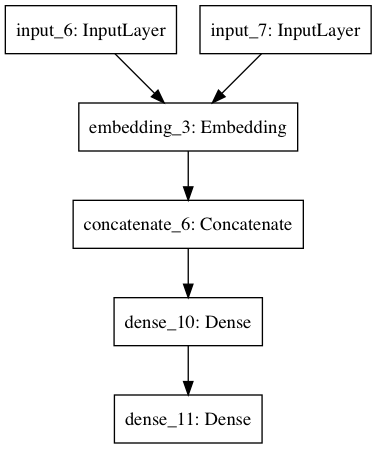

In [25]:
tf.keras.utils.plot_model(model)

In [24]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 32)]         0                                            
__________________________________________________________________________________________________
input_7 (InputLayer)            [(None, 16)]         0                                            
__________________________________________________________________________________________________
embedding_3 (Embedding)         multiple             64000       input_6[0][0]                    
                                                                 input_7[0][0]                    
__________________________________________________________________________________________________
concatenate_6 (Concatenate)     (None, 48, 64)       0           embedding_3[4][0]          

## tf.keras.layers.Dense
Dense implements the operation: output = activation(dot(input, kernel) + bias) where activation is the element-wise activation function passed as the activation argument, kernel is a weights matrix created by the layer, and bias is a bias vector created by the layer (only applicable if use_bias is True).


输入数组的形状: (batch_size, ..., input_dim),  输出数组的形状: (batch_size, ..., units), 即把最后一维的维度由input_dim转换为units，units为Dense层unit_num

In [ ]:
tf.keras.layers.Dense(
    units, activation=None, use_bias=True, kernel_initializer='glorot_uniform',
    bias_initializer='zeros', kernel_regularizer=None, bias_regularizer=None,
    activity_regularizer=None, kernel_constraint=None, bias_constraint=None,
    **kwargs
)

## tf.keras.layers.Lambda
Wraps arbitrary expressions as a Layer object.

存在Lambda层，以便在构造顺序和功能API模型时可以使用任意TensorFlow函数。 

__Lambda层最适合简单操作或快速实验__。

继承tf.keras.layers.Layer而不使用Lambda图层的主要原因是保存和检查模型。 

Lambda图层是通过序列化Python字节码来保存的，而子类化的Layer可以通过覆盖其get_config方法来保存。 覆盖get_config可改善模型的可移植性。 依赖于子类化图层的模型通常也更易于可视化和推理。

In [ ]:
tf.keras.layers.Lambda(
    function, output_shape=None, mask=None, arguments=None, **kwargs
)

In [ ]:
# add a x -> x^2 layer
model.add(Lambda(lambda x: x ** 2))

In [ ]:
# add a layer that returns the concatenation
# of the positive part of the input and
# the opposite of the negative part

def antirectifier(x):
    x -= K.mean(x, axis=1, keepdims=True)
    x = K.l2_normalize(x, axis=1)
    pos = K.relu(x)
    neg = K.relu(-x)
    return K.concatenate([pos, neg], axis=1)

model.add(Lambda(antirectifier))

## tf.keras.layers.Reshape
Reshapes an output to a certain shape.

* Input shape: 不包含batch size axis  
Arbitrary, although all dimensions in the input shape must be known/fixed. Use the keyword argument input_shape (tuple of integers, does not include the samples/batch size axis) when using this layer as the first layer in a model.  
* Output shape:

(batch_size,) + target_shape

In [ ]:
tf.keras.layers.Reshape(
    target_shape, **kwargs
)

In [ ]:
# as first layer in a Sequential model
model = Sequential()
model.add(Reshape((3, 4), input_shape=(12,)))
# now: model.output_shape == (None, 3, 4)
# note: `None` is the batch dimension

# as intermediate layer in a Sequential model
model.add(Reshape((6, 2)))
# now: model.output_shape == (None, 6, 2)

# also supports shape inference using `-1` as dimension
model.add(Reshape((-1, 2, 2)))
# now: model.output_shape == (None, None, 2, 2)

## tf.keras.layers.Conv2D
This layer creates a convolution kernel that is convolved with the layer input to produce a tensor of outputs. If use_bias is True, a bias vector is created and added to the outputs. Finally, if activation is not None, it is applied to the outputs as well.

When using this layer as the first layer in a model, provide the keyword argument input_shape (tuple of integers, does not include the sample axis), e.g. input_shape=(128, 128, 3) for 128x128 RGB pictures in data_format="channels_last".

In [ ]:
tf.keras.layers.Conv2D(
    filters, kernel_size, strides=(1, 1), padding='valid', data_format=None,
    dilation_rate=(1, 1), activation=None, use_bias=True,
    kernel_initializer='glorot_uniform', bias_initializer='zeros',
    kernel_regularizer=None, bias_regularizer=None, activity_regularizer=None,
    kernel_constraint=None, bias_constraint=None, **kwargs
)

* data_format: A string, one of channels_last (default) or channels_first.
    
* Input shape:

4D tensor with shape: (samples, channels, rows, cols) if data_format='channels_first' or 4D tensor with shape: (samples, rows, cols, channels) if data_format='channels_last'.
* Output shape:

4D tensor with shape: (samples, filters, new_rows, new_cols) if data_format='channels_first' or 4D tensor with shape: (samples, new_rows, new_cols, filters) if data_format='channels_last'. rows and cols values might have changed due to padding.

## tf.keras.layers.GlobalAveragePooling1D
Global average pooling operation for temporal data.

沿着时序的维度压缩为1维，取均值

Input shape:

    If data_format='channels_last': 3D tensor with shape: (batch_size, steps, features)
    If data_format='channels_first': 3D tensor with shape: (batch_size, features, steps)

Output shape:

2D tensor with shape (batch_size, features).

In [ ]:
tf.keras.layers.GlobalAveragePooling1D(
    data_format='channels_last', **kwargs
)

In [31]:
input_shape = (2, 3, 4)
x = tf.random.normal(input_shape)
y = tf.keras.layers.GlobalAveragePooling1D()(x)
print(y.shape)

(2, 4)


In [32]:
input_shape = (2, 3, 4, 5)
x = tf.random.normal(input_shape)
y = tf.keras.layers.GlobalAveragePooling1D()(x)
print(y.shape)

ValueError: Input 0 of layer global_average_pooling1d_1 is incompatible with the layer: expected ndim=3, found ndim=4. Full shape received: [2, 3, 4, 5]

## tf.keras.layers.BatchNormalization
https://tensorflow.google.cn/api_docs/python/tf/keras/layers/BatchNormalization

Normalize and scale inputs or activations. (Ioffe and Szegedy, 2014).

在每批中对上一层的激活进行归一化，即应用转换以将平均激活保持在0附近并将激活标准偏差保持在1附近。

批处理规范化在几个关键方面与其他层不同：

1）在模型上添加`training=True`的BatchNormalization，会使一个示例的结果取决于微型批次中所有其他示例的内容。 在填充批处理或掩盖示例时要小心，因为它们可能会更改小批量统计信息并影响其他示例。Be careful when padding batches or masking examples, as these can change the minibatch statistics and affect other examples.

2）权重（移动统计量）的更新基于模型的前向传递，而不是基于梯度计算的结果。

3）当使用包含批处理归一化的模型执行推理时，通常（尽管并非总是）希望使用累积的统计信息而不是小批量的统计信息。 这可以通过在调用模型时使用`training = False`或使用`model.predict`来实现。

In [ ]:
tf.keras.layers.BatchNormalization(
    axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True,
    beta_initializer='zeros', gamma_initializer='ones',
    moving_mean_initializer='zeros', moving_variance_initializer='ones',
    beta_regularizer=None, gamma_regularizer=None, beta_constraint=None,
    gamma_constraint=None, renorm=False, renorm_clipping=None, renorm_momentum=0.99,
    fused=None, trainable=True, virtual_batch_size=None, adjustment=None, name=None,
    **kwargs
)

## Custom layers
Create a custom layer by subclassing `tf.keras.layers.Layer` and implementing the following methods:

* `__init__`: Optionally define sublayers to be used by this layer.
* build:   
Create the weights of the layer. Add weights with the add_weight method.
* call:   
Define the forward pass.
* Optionally, a layer can be serialized by implementing the get_config method and the from_config class method.

Here's an example of a custom layer that implements a matmul of an input with a kernel matrix:

In [ ]:
class MyLayer(layers.Layer):

    def __init__(self, output_dim, **kwargs):
        self.output_dim = output_dim
        super(MyLayer, self).__init__(**kwargs)

    def build(self, input_shape):
        # Create a trainable weight variable for this layer.
        self.kernel = self.add_weight(name='kernel',
                                  shape=(input_shape[1], self.output_dim),
                                  initializer='uniform',
                                  trainable=True)

    def call(self, inputs):
        return tf.matmul(inputs, self.kernel)

    def get_config(self):
        base_config = super(MyLayer, self).get_config()
        base_config['output_dim'] = self.output_dim
        return base_config

    @classmethod
    def from_config(cls, config):
        return cls(**config)

In [23]:
# Create a model using your custom layer:
model = tf.keras.Sequential([
    MyLayer(10),
    layers.Activation('softmax')])

# The compile step specifies the training configuration
model.compile(optimizer=tf.keras.optimizers.RMSprop(0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Trains for 5 epochs.
model.fit(data, labels, batch_size=32, epochs=2)

Train on 10 samples
Epoch 1/2
10/10 [==============================] - 1s 60ms/sample - loss: 12.5253 - accuracy: 0.3000
Epoch 2/2
10/10 [==============================] - 0s 641us/sample - loss: 12.5253 - accuracy: 0.3000


# Model
model就是一个layers的组合。Keras内置了两个model类
## tf.keras.Model
https://tensorflow.google.cn/api_docs/python/tf/keras/Model

通用的模型类。Model groups layers into an object with training and inference features.
### Attributes
* layers: 获取模型的layers list  
model.layers[0].get_weights() # 获取第0层layer的权重  

* metrics_names: Returns the model's display labels for all outputs.

Note: metrics_names are available only after a keras.Model has been trained/evaluated on actual data.

* run_eagerly：Settable属性，指示模型是否应热切运行。

* state_updates：返回所有有状态层的更新。

* distribute_strategy: The tf.distribute.Strategy this model was created under.

### Methods
#### compile  
Configures the model for training.

    compile(
        optimizer='rmsprop', loss=None, metrics=None, loss_weights=None,
        sample_weight_mode=None, weighted_metrics=None, **kwargs
    )

* loss: objective function  
用于梯度计算，梯度下降会使得loss值越来越小  
String (name of objective function), objective function or tf.keras.losses.Loss instance. See tf.keras.losses. An objective function is any callable with the signature loss = fn(y_true, y_pred), where y_true = ground truth values with shape = [batch_size, d0, .. dN], except sparse loss functions such as sparse categorical crossentropy where shape = [batch_size, d0, .. dN-1]. y_pred = predicted values with shape = [batch_size, d0, .. dN]. 

* metrics: List of metrics to be evaluated by the model during training and testing. Each of this can be a string (name of a built-in function), function or a tf.keras.metrics.Metric instance.


#### evaluate  
Returns the loss value & metrics values for the model in test mode.

Computation is done in batches.

    evaluate(
        x=None, y=None, batch_size=None, verbose=1, sample_weight=None, steps=None,
        callbacks=None, max_queue_size=10, workers=1, use_multiprocessing=False,
        return_dict=False
    )

#### fit  
Trains the model for a fixed number of epochs (iterations on a dataset).

    fit(
        x=None, y=None, batch_size=None, epochs=1, verbose=1, callbacks=None,
        validation_split=0.0, validation_data=None, shuffle=True, class_weight=None,
        sample_weight=None, initial_epoch=0, steps_per_epoch=None,
        validation_steps=None, validation_batch_size=None, validation_freq=1,
        max_queue_size=10, workers=1, use_multiprocessing=False
    )
Arguments:  
x: Input data. It could be:

    A Numpy array (or array-like), or a list of arrays (in case the model has multiple inputs).
    A TensorFlow tensor, or a list of tensors (in case the model has multiple inputs).
    A dict mapping input names to the corresponding array/tensors, if the model has named inputs.
    A tf.data dataset. Should return a tuple of either (inputs, targets) or (inputs, targets, sample_weights).
    A generator or keras.utils.Sequence returning (inputs, targets) or (inputs, targets, sample_weights). A more detailed description of unpacking behavior for iterator types (Dataset, generator, Sequence) is given below.


Returns:  
A History object. Its History.history attribute is a record of training loss values and metrics values at successive epochs, as well as validation loss values and validation metrics values (if applicable).

#### train_on_batch  
Runs a single gradient update on a single batch of data.

train_on_batch(
    x, y=None, sample_weight=None, class_weight=None, reset_metrics=True,
    return_dict=False
)

### tf.keras.Sequential  
Sequential groups a linear stack of layers into a tf.keras.Model.  
Sequential是tf.keras.Model的子类


## Model subclassing
https://tensorflow.google.cn/guide/keras/overview#model_subclassing

Build a fully-customizable model by subclassing tf.keras.Model and defining your own forward pass. 

Create layers in the __init__ method and set them as attributes of the class instance. 

Define the forward pass in the call method.

Model subclassing is particularly useful when eager execution is enabled, because it allows the forward pass to be written imperatively.

Note: if you need your model to always run imperatively, you can set dynamic=True when calling the super constructor.

    Key Point: Use the right API for the job. While model subclassing offers flexibility, it comes at a cost of greater complexity and more opportunities for user errors. If possible, prefer the functional API.

The following example shows a subclassed tf.keras.Model using a custom forward pass that does not have to be run imperatively:

In [20]:
class MyModel(tf.keras.Model):

    def __init__(self, num_classes=10):
        super(MyModel, self).__init__(name='my_model')
        self.num_classes = num_classes
        # Define your layers here.
        self.dense_1 = layers.Dense(32, activation='relu')
        self.dense_2 = layers.Dense(num_classes, activation='sigmoid')

    def call(self, inputs):
        # Define your forward pass here,
        # using layers you previously defined (in `__init__`).
        x = self.dense_1(inputs)
        return self.dense_2(x)

In [21]:
# Instantiate the new model class:
model = MyModel(num_classes=10)

# The compile step specifies the training configuration.
model.compile(optimizer=tf.keras.optimizers.RMSprop(0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Trains for 5 epochs.
model.fit(data, labels, batch_size=32, epochs=2)

Train on 10 samples
Epoch 1/2
10/10 [==============================] - 1s 124ms/sample - loss: 12.6439 - accuracy: 0.0000e+00
Epoch 2/2
10/10 [==============================] - 0s 490us/sample - loss: 12.5796 - accuracy: 0.0000e+00


# Recurrent Neural Networks (RNN) with Keras
https://tensorflow.google.cn/guide/keras/rnn

In [1]:
import collections
import matplotlib.pyplot as plt
import numpy as np

import tensorflow as tf

from tensorflow.keras import layers

## Build a simple model
There are three built-in RNN layers in Keras:

* tf.keras.layers.SimpleRNN, a fully-connected RNN where the output from previous timestep is to be fed to next timestep.

* tf.keras.layers.GRU, first proposed in Learning Phrase Representations using RNN Encoder-Decoder for Statistical Machine Translation.

* tf.keras.layers.LSTM, first proposed in Long Short-Term Memory.

In early 2015, Keras had the first reusable open-source Python implementations of LSTM and GRU.

Here is a simple example of a Sequential model that processes sequences of integers, embeds each integer into a 64-dimensional vector, then processes the sequence of vectors using a LSTM layer.

In [2]:
model = tf.keras.Sequential()
# Add an Embedding layer expecting input vocab of size 1000, and
# output embedding dimension of size 64.
model.add(layers.Embedding(input_dim=1000, output_dim=64))

# Add a LSTM layer with 128 internal units.
model.add(layers.LSTM(128))

# Add a Dense layer with 10 units and softmax activation.
model.add(layers.Dense(10, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 64)          64000     
_________________________________________________________________
lstm (LSTM)                  (None, 128)               98816     
_________________________________________________________________
dense (Dense)                (None, 10)                1290      
Total params: 164,106
Trainable params: 164,106
Non-trainable params: 0
_________________________________________________________________


## Outputs and states
By default, the output of a RNN layer contain a single vector per sample. This vector is the RNN cell output corresponding to the last timestep, containing information about the entire input sequence. The shape of this output is **(batch_size, units)** where units corresponds to the units argument passed to the layer's constructor.

A RNN layer can also return the entire sequence of outputs for each sample (one vector per timestep per sample), if you set `return_sequences=True`. The shape of this output is **(batch_size, timesteps, units)**.

In [3]:
model = tf.keras.Sequential()
model.add(layers.Embedding(input_dim=1000, output_dim=64))

# The output of GRU will be a 3D tensor of shape (batch_size, timesteps, 256)
model.add(layers.GRU(256, return_sequences=True))

# The output of SimpleRNN will be a 2D tensor of shape (batch_size, 128)
model.add(layers.SimpleRNN(128))

model.add(layers.Dense(10, activation='softmax'))

model.summary() 

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, None, 64)          64000     
_________________________________________________________________
gru (GRU)                    (None, None, 256)         247296    
_________________________________________________________________
simple_rnn (SimpleRNN)       (None, 128)               49280     
_________________________________________________________________
dense_1 (Dense)              (None, 10)                1290      
Total params: 361,866
Trainable params: 361,866
Non-trainable params: 0
_________________________________________________________________


### encoder-decoder sequence-to-sequence model

In addition, a RNN layer can return its final internal state(s). The returned states can be used to resume the RNN execution later, or to initialize another RNN. This setting is commonly used in the encoder-decoder sequence-to-sequence model, where the encoder final state is used as the initial state of the decoder.

To configure a RNN layer to return its internal state, set the return_state parameter to True when creating the layer. **Note that LSTM has 2 state tensors, but GRU only has one**.

To configure the initial state of the layer, just call the layer with additional keyword argument initial_state. Note that the shape of the state needs to match the unit size of the layer, like in the example below.

In [4]:
encoder_vocab = 1000
decoder_vocab = 2000

encoder_input = layers.Input(shape=(None, ))
encoder_embedded = layers.Embedding(input_dim=encoder_vocab, output_dim=64)(encoder_input)

# Return states in addition to output
output, state_h, state_c = layers.LSTM(
    64, return_state=True, name='encoder')(encoder_embedded)
encoder_state = [state_h, state_c]

decoder_input = layers.Input(shape=(None, ))
decoder_embedded = layers.Embedding(input_dim=decoder_vocab, output_dim=64)(decoder_input)

# Pass the 2 states to a new LSTM layer, as initial state
decoder_output = layers.LSTM(
    64, name='decoder')(decoder_embedded, initial_state=encoder_state)
output = layers.Dense(10, activation='softmax')(decoder_output)

model = tf.keras.Model([encoder_input, decoder_input], output)
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None)]       0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, None)]       0                                            
__________________________________________________________________________________________________
embedding_2 (Embedding)         (None, None, 64)     64000       input_1[0][0]                    
__________________________________________________________________________________________________
embedding_3 (Embedding)         (None, None, 64)     128000      input_2[0][0]                    
______________________________________________________________________________________________

## Bidirectional RNNs
For sequences other than time series (e.g. text), it is often the case that a RNN model can perform better if it not only processes sequence from start to end, but also backwards. For example, to predict the next word in a sentence, it is often useful to have the context around the word, not only just the words that come before it.

Keras provides an easy API for you to build such bidirectional RNNs: the tf.keras.layers.Bidirectional wrapper.

In [5]:
model = tf.keras.Sequential()

model.add(layers.Bidirectional(layers.LSTM(64, return_sequences=True), 
                               input_shape=(5, 10)))
model.add(layers.Bidirectional(layers.LSTM(32)))
model.add(layers.Dense(10, activation='softmax'))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional (Bidirectional (None, 5, 128)            38400     
_________________________________________________________________
bidirectional_1 (Bidirection (None, 64)                41216     
_________________________________________________________________
dense_3 (Dense)              (None, 10)                650       
Total params: 80,266
Trainable params: 80,266
Non-trainable params: 0
_________________________________________________________________


# Masking and padding with Keras

## Padding sequence data
在处理序列数据时，通常每个样本的长度是不同的。考虑以下示例(文本标记为单词)

In [6]:
[
  ["The", "weather", "will", "be", "nice", "tomorrow"],
  ["How", "are", "you", "doing", "today"],
  ["Hello", "world", "!"]
]

[['The', 'weather', 'will', 'be', 'nice', 'tomorrow'],
 ['How', 'are', 'you', 'doing', 'today'],
 ['Hello', 'world', '!']]

After vocabulary lookup, the data might be vectorized as integers, e.g.:

In [7]:
[
  [83, 91, 1, 645, 1253, 927],
  [73, 8, 3215, 55, 927],
  [71, 1331, 4231]
]

[[83, 91, 1, 645, 1253, 927], [73, 8, 3215, 55, 927], [71, 1331, 4231]]

数据是2D列表，其中各个样本的长度分别为6、5和3。 由于深度学习模型的输入数据必须是单个张量（在这种情况下，形状为例如（batch_size，6，vocab_size）的形状），因此，比最长的项目短的样本需要填充一些占位符值（或者，一个占位符） 可能还会在填充短样本之前截断长样本）。

Keras provides an API to easily truncate and pad sequences to a common length: tf.keras.preprocessing.sequence.pad_sequences.

In [2]:
import tensorflow as tf

In [3]:
raw_inputs = [
  [83, 91, 1, 645, 1253, 927],
  [73, 8, 3215, 55, 927],
  [711, 632, 71]
]

# By default, this will pad using 0s; it is configurable via the
# "value" parameter.
# Note that you could "pre" padding (at the beginning) or
# "post" padding (at the end).
# We recommend using "post" padding when working with RNN layers
# (in order to be able to use the 
# CuDNN implementation of the layers).
padded_inputs = tf.keras.preprocessing.sequence.pad_sequences(raw_inputs,
                                                              padding='post')

print(padded_inputs)

[[  83   91    1  645 1253  927]
 [  73    8 3215   55  927    0]
 [ 711  632   71    0    0    0]]


## Masking
既然所有的样本都有一个统一的长度，就必须通知模型，数据的某些部分实际上是填充的，应该忽略。这个机制是masking。

在Keras模型中引入输入掩码有三种方法

* Add a `keras.layers.Masking` layer.
* Configure a `keras.layers.Embedding` layer with `mask_zero=True`.
* Pass a mask argument manually when calling layers that support this argument (e.g. RNN layers).

### Mask-generating layers: Embedding and Masking
Under the hood, 这些层将创建一个遮罩张量mask tensor（形状为（batch，sequence_length）的2D张量），并将其附加到由Masking或Embedding层返回的张量输出。

In [5]:
embedding = tf.keras.layers.Embedding(input_dim=5000, output_dim=16, mask_zero=True)
masked_output = embedding(padded_inputs)

print(masked_output._keras_mask)

tf.Tensor(
[[ True  True  True  True  True  True]
 [ True  True  True  True  True False]
 [ True  True  True False False False]], shape=(3, 6), dtype=bool)


In [11]:
masking_layer = layers.Masking()
# Simulate the embedding lookup by expanding the 2D input to 3D,
# with embedding dimension of 10.
unmasked_embedding = tf.cast(
    tf.tile(tf.expand_dims(padded_inputs, axis=-1), [1, 1, 10]),
    tf.float32)

masked_embedding = masking_layer(unmasked_embedding)
print(masked_embedding._keras_mask)

tf.Tensor(
[[ True  True  True  True  True  True]
 [ True  True  True  True  True False]
 [ True  True  True False False False]], shape=(3, 6), dtype=bool)


从打印结果中可以看到，the mask是具有形状（batch_size，sequence_length）的2D布尔张量，其中每个False条目表示在处理过程中应忽略相应的时间步长。

### Mask propagation(传播) in the Functional API and Sequential API
使用功能性API或顺序性API时，对于可以使用它们的任何层（例如，RNN层），由嵌入或掩膜层生成的掩膜将通过网络传播。 Keras将自动获取与输入相对应的遮罩，并将其传递给知道如何使用该遮罩的任何层。

请注意，在子类化模型或图层的call方法中，遮罩不会自动传播，因此您将需要手动将遮罩参数传递给需要一个图层的任何图层。 详情请参阅以下部分

例如，在以下顺序模型中，LSTM层将自动接收掩码，这意味着它将忽略填充值：

In [ ]:
model = tf.keras.Sequential([
  layers.Embedding(input_dim=5000, output_dim=16, mask_zero=True),
  layers.LSTM(32),
])




下面的函数API模型也是这种情况

In [ ]:
inputs = tf.keras.Input(shape=(None,), dtype='int32')
x = layers.Embedding(input_dim=5000, output_dim=16, mask_zero=True)(inputs)
outputs = layers.LSTM(32)(x)

model = tf.keras.Model(inputs, outputs)

# Word embeddings
## Representing text as numbers
* One-hot encodings
* Encode each word with a unique number
* Word embeddings

In [19]:
# !pip install tensorflow_datasets
!pip freeze | grep tensorflow-datasets

tensorflow-datasets==1.3.0


In [20]:
from tensorflow import keras
from tensorflow.keras import layers

import tensorflow_datasets as tfds
tfds.disable_progress_bar()

## Using the Embedding layer
Keras makes it easy to use word embeddings. Let's take a look at the Embedding layer.

The Embedding layer can be understood as a lookup table that maps from integer indices (which stand for specific words) to dense vectors (their embeddings). The dimensionality (or width) of the embedding is a parameter you can experiment with to see what works well for your problem, much in the same way you would experiment with the number of neurons in a Dense layer.

In [21]:
embedding_layer = layers.Embedding(1000, 5)

When you create an Embedding layer, the weights for the embedding are randomly initialized (just like any other layer). During training, they are gradually adjusted via backpropagation. Once trained, the learned word embeddings will roughly encode similarities between words (as they were learned for the specific problem your model is trained on).

If you pass an integer to an embedding layer, the result replaces each integer with the vector from the embedding table:

In [22]:
result = embedding_layer(tf.constant([1,2,3]))
result

<tf.Tensor: id=4543, shape=(3, 5), dtype=float32, numpy=
array([[ 0.00241987, -0.01758017, -0.01845681,  0.0114537 ,  0.03800228],
       [ 0.043493  ,  0.0058952 , -0.00655357,  0.04754883, -0.03791286],
       [ 0.03135024,  0.01157562, -0.01283092, -0.0042626 , -0.01847968]],
      dtype=float32)>

In [23]:
result.numpy()

array([[ 0.00241987, -0.01758017, -0.01845681,  0.0114537 ,  0.03800228],
       [ 0.043493  ,  0.0058952 , -0.00655357,  0.04754883, -0.03791286],
       [ 0.03135024,  0.01157562, -0.01283092, -0.0042626 , -0.01847968]],
      dtype=float32)

In [24]:
result = embedding_layer(tf.constant([[0,1,2],[3,4,5]]))
result.shape

TensorShape([2, 3, 5])

# 回归

## 线性回归

### Sequential

In [1]:
import keras
import numpy as np
import matplotlib.pyplot as plt
# Sequential按顺序构成的模型
from keras.models import Sequential
# Dense全连接层
from keras.layers import Dense

Using TensorFlow backend.


In [2]:
# 使用numpy生成100个随机点
x_data = np.random.rand(100).reshape(-1, 1)
noise = np.random.normal(0,0.01,x_data.shape)
y_data = x_data*0.1 + 0.2 + noise

In [3]:
x_data[:5]

array([[0.31958133],
       [0.87239517],
       [0.65532874],
       [0.73693056],
       [0.73152284]])

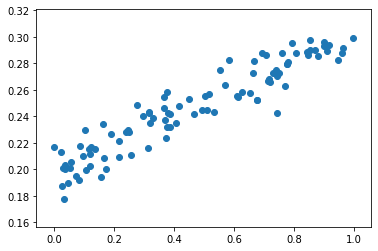

In [4]:
# 显示随机点
plt.scatter(x_data,y_data)
plt.show()

In [5]:
# 构建一个顺序模型
model = Sequential()
# 在模型中添加一个全连接层
model.add(Dense(units=1,input_shape=(1,)))
# sgd:Stochastic gradient descent，随机梯度下降法
# mse:Mean Squared Error，均方误差
model.compile(optimizer='sgd',loss='mse')

# 训练3001个批次
for step in range(3001):
    # 每次训练一个批次
    cost = model.train_on_batch(x_data,y_data)
    # 每500个batch打印一次cost值
    if step % 500 == 0:
        print('cost:',cost)
        
# 打印权值和偏置值
W,b = model.layers[0].get_weights()
print('W:',W,'b:',b)

# x_data输入网络中，得到预测值y_pred
y_pred = model.predict(x_data)

cost: 0.2640016
cost: 0.0036001303
cost: 0.0009515557
cost: 0.0003159303
cost: 0.00016338678
cost: 0.00012677812
cost: 0.00011799245
W: [[0.096593]] b: [0.20200638]


In [7]:
type(model)

keras.engine.sequential.Sequential

In [8]:
model.metrics_names

['loss']

In [9]:
model.state_updates

[]

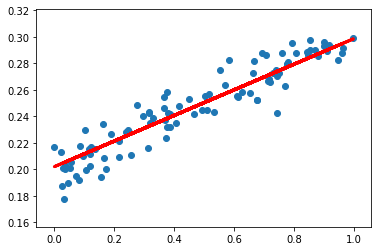

In [6]:
# 显示随机点
plt.scatter(x_data,y_data)
# 显示预测结果
plt.plot(x_data,y_pred,'r-',lw=3)
plt.show()

### Fuctional

In [4]:
import tensorflow as tf
from tensorflow.keras import Input, Model

from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam

In [6]:
# 使用numpy生成100个随机点
x_data = np.random.rand(100).reshape(-1, 1)
noise = np.random.normal(0,0.01,x_data.shape)
y_data = x_data*0.1 + 0.2 + noise

In [5]:
inputs = Input((1, ))
predictions = Dense(1)(inputs)
model = Model(inputs=inputs, outputs=predictions)
model.compile(Adam(0.001), loss='mse', metrics=['accuracy'])
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1)]               0         
_________________________________________________________________
dense (Dense)                (None, 1)                 2         
Total params: 2
Trainable params: 2
Non-trainable params: 0
_________________________________________________________________


In [14]:
history = model.fit(x_data, y_data, batch_size=128, epochs=3000, verbose=1)

Train on 100 samples
Epoch 1/3000
100/100 [==============================] - 0s 71us/sample - loss: 4.4681e-04 - accuracy: 0.0000e+00
Epoch 2/3000
100/100 [==============================] - 0s 31us/sample - loss: 4.4366e-04 - accuracy: 0.0000e+00
Epoch 3/3000
100/100 [==============================] - 0s 36us/sample - loss: 4.4054e-04 - accuracy: 0.0000e+00
Epoch 4/3000
100/100 [==============================] - 0s 26us/sample - loss: 4.3745e-04 - accuracy: 0.0000e+00
Epoch 5/3000
100/100 [==============================] - 0s 52us/sample - loss: 4.3438e-04 - accuracy: 0.0000e+00
Epoch 6/3000
100/100 [==============================] - 0s 19us/sample - loss: 4.3133e-04 - accuracy: 0.0000e+00
Epoch 7/3000
100/100 [==============================] - 0s 24us/sample - loss: 4.2831e-04 - accuracy: 0.0000e+00
Epoch 8/3000
100/100 [==============================] - 0s 18us/sample - loss: 4.2531e-04 - accuracy: 0.0000e+00
Epoch 9/3000
100/100 [==============================] - 0s 20us/sample - lo

Epoch 73/3000
100/100 [==============================] - 0s 43us/sample - loss: 2.7420e-04 - accuracy: 0.0000e+00
Epoch 74/3000
100/100 [==============================] - 0s 34us/sample - loss: 2.7245e-04 - accuracy: 0.0000e+00
Epoch 75/3000
100/100 [==============================] - 0s 46us/sample - loss: 2.7072e-04 - accuracy: 0.0000e+00
Epoch 76/3000
100/100 [==============================] - 0s 26us/sample - loss: 2.6900e-04 - accuracy: 0.0000e+00
Epoch 77/3000
100/100 [==============================] - 0s 36us/sample - loss: 2.6730e-04 - accuracy: 0.0000e+00
Epoch 78/3000
100/100 [==============================] - 0s 44us/sample - loss: 2.6561e-04 - accuracy: 0.0000e+00
Epoch 79/3000
100/100 [==============================] - 0s 17us/sample - loss: 2.6394e-04 - accuracy: 0.0000e+00
Epoch 80/3000
100/100 [==============================] - 0s 22us/sample - loss: 2.6228e-04 - accuracy: 0.0000e+00
Epoch 81/3000
100/100 [==============================] - 0s 34us/sample - loss: 2.6063e-

Epoch 145/3000
100/100 [==============================] - 0s 35us/sample - loss: 1.8053e-04 - accuracy: 0.0000e+00
Epoch 146/3000
100/100 [==============================] - 0s 19us/sample - loss: 1.7961e-04 - accuracy: 0.0000e+00
Epoch 147/3000
100/100 [==============================] - 0s 44us/sample - loss: 1.7870e-04 - accuracy: 0.0000e+00
Epoch 148/3000
100/100 [==============================] - 0s 23us/sample - loss: 1.7779e-04 - accuracy: 0.0000e+00
Epoch 149/3000
100/100 [==============================] - 0s 23us/sample - loss: 1.7690e-04 - accuracy: 0.0000e+00
Epoch 150/3000
100/100 [==============================] - 0s 52us/sample - loss: 1.7601e-04 - accuracy: 0.0000e+00
Epoch 151/3000
100/100 [==============================] - 0s 22us/sample - loss: 1.7513e-04 - accuracy: 0.0000e+00
Epoch 152/3000
100/100 [==============================] - 0s 46us/sample - loss: 1.7426e-04 - accuracy: 0.0000e+00
Epoch 153/3000
100/100 [==============================] - 0s 28us/sample - loss:

Epoch 217/3000
100/100 [==============================] - 0s 19us/sample - loss: 1.3237e-04 - accuracy: 0.0000e+00
Epoch 218/3000
100/100 [==============================] - 0s 33us/sample - loss: 1.3191e-04 - accuracy: 0.0000e+00
Epoch 219/3000
100/100 [==============================] - 0s 33us/sample - loss: 1.3146e-04 - accuracy: 0.0000e+00
Epoch 220/3000
100/100 [==============================] - 0s 54us/sample - loss: 1.3101e-04 - accuracy: 0.0000e+00
Epoch 221/3000
100/100 [==============================] - 0s 51us/sample - loss: 1.3056e-04 - accuracy: 0.0000e+00
Epoch 222/3000
100/100 [==============================] - 0s 21us/sample - loss: 1.3012e-04 - accuracy: 0.0000e+00
Epoch 223/3000
100/100 [==============================] - 0s 41us/sample - loss: 1.2969e-04 - accuracy: 0.0000e+00
Epoch 224/3000
100/100 [==============================] - 0s 19us/sample - loss: 1.2926e-04 - accuracy: 0.0000e+00
Epoch 225/3000
100/100 [==============================] - 0s 38us/sample - loss:

Epoch 289/3000
100/100 [==============================] - 0s 37us/sample - loss: 1.0894e-04 - accuracy: 0.0000e+00
Epoch 290/3000
100/100 [==============================] - 0s 26us/sample - loss: 1.0873e-04 - accuracy: 0.0000e+00
Epoch 291/3000
100/100 [==============================] - 0s 39us/sample - loss: 1.0851e-04 - accuracy: 0.0000e+00
Epoch 292/3000
100/100 [==============================] - 0s 46us/sample - loss: 1.0830e-04 - accuracy: 0.0000e+00
Epoch 293/3000
100/100 [==============================] - 0s 25us/sample - loss: 1.0809e-04 - accuracy: 0.0000e+00
Epoch 294/3000
100/100 [==============================] - 0s 28us/sample - loss: 1.0789e-04 - accuracy: 0.0000e+00
Epoch 295/3000
100/100 [==============================] - 0s 39us/sample - loss: 1.0768e-04 - accuracy: 0.0000e+00
Epoch 296/3000
100/100 [==============================] - 0s 21us/sample - loss: 1.0748e-04 - accuracy: 0.0000e+00
Epoch 297/3000
100/100 [==============================] - 0s 46us/sample - loss:

Epoch 361/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.8170e-05 - accuracy: 0.0000e+00
Epoch 362/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.8074e-05 - accuracy: 0.0000e+00
Epoch 363/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.7979e-05 - accuracy: 0.0000e+00
Epoch 364/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.7885e-05 - accuracy: 0.0000e+00
Epoch 365/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.7792e-05 - accuracy: 0.0000e+00
Epoch 366/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.7700e-05 - accuracy: 0.0000e+00
Epoch 367/3000
100/100 [==============================] - 0s 47us/sample - loss: 9.7609e-05 - accuracy: 0.0000e+00
Epoch 368/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.7520e-05 - accuracy: 0.0000e+00
Epoch 369/3000
100/100 [==============================] - 0s 38us/sample - loss:

Epoch 433/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.3490e-05 - accuracy: 0.0000e+00
Epoch 434/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.3450e-05 - accuracy: 0.0000e+00
Epoch 435/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.3410e-05 - accuracy: 0.0000e+00
Epoch 436/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.3370e-05 - accuracy: 0.0000e+00
Epoch 437/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.3332e-05 - accuracy: 0.0000e+00
Epoch 438/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.3293e-05 - accuracy: 0.0000e+00
Epoch 439/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.3255e-05 - accuracy: 0.0000e+00
Epoch 440/3000
100/100 [==============================] - 0s 39us/sample - loss: 9.3218e-05 - accuracy: 0.0000e+00
Epoch 441/3000
100/100 [==============================] - 0s 21us/sample - loss:

Epoch 505/3000
100/100 [==============================] - 0s 37us/sample - loss: 9.1572e-05 - accuracy: 0.0000e+00
Epoch 506/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.1556e-05 - accuracy: 0.0000e+00
Epoch 507/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.1541e-05 - accuracy: 0.0000e+00
Epoch 508/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.1525e-05 - accuracy: 0.0000e+00
Epoch 509/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.1510e-05 - accuracy: 0.0000e+00
Epoch 510/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.1494e-05 - accuracy: 0.0000e+00
Epoch 511/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.1480e-05 - accuracy: 0.0000e+00
Epoch 512/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.1465e-05 - accuracy: 0.0000e+00
Epoch 513/3000
100/100 [==============================] - 0s 20us/sample - loss:

Epoch 577/3000
100/100 [==============================] - 0s 41us/sample - loss: 9.0832e-05 - accuracy: 0.0000e+00
Epoch 578/3000
100/100 [==============================] - 0s 50us/sample - loss: 9.0826e-05 - accuracy: 0.0000e+00
Epoch 579/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0820e-05 - accuracy: 0.0000e+00
Epoch 580/3000
100/100 [==============================] - 0s 40us/sample - loss: 9.0814e-05 - accuracy: 0.0000e+00
Epoch 581/3000
100/100 [==============================] - 0s 66us/sample - loss: 9.0808e-05 - accuracy: 0.0000e+00
Epoch 582/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0803e-05 - accuracy: 0.0000e+00
Epoch 583/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0797e-05 - accuracy: 0.0000e+00
Epoch 584/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0792e-05 - accuracy: 0.0000e+00
Epoch 585/3000
100/100 [==============================] - 0s 28us/sample - loss:

Epoch 649/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0562e-05 - accuracy: 0.0000e+00
Epoch 650/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0560e-05 - accuracy: 0.0000e+00
Epoch 651/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0558e-05 - accuracy: 0.0000e+00
Epoch 652/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0556e-05 - accuracy: 0.0000e+00
Epoch 653/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0554e-05 - accuracy: 0.0000e+00
Epoch 654/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.0552e-05 - accuracy: 0.0000e+00
Epoch 655/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0550e-05 - accuracy: 0.0000e+00
Epoch 656/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0549e-05 - accuracy: 0.0000e+00
Epoch 657/3000
100/100 [==============================] - 0s 37us/sample - loss:

Epoch 721/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0471e-05 - accuracy: 0.0000e+00
Epoch 722/3000
100/100 [==============================] - 0s 17us/sample - loss: 9.0470e-05 - accuracy: 0.0000e+00
Epoch 723/3000
100/100 [==============================] - 0s 37us/sample - loss: 9.0469e-05 - accuracy: 0.0000e+00
Epoch 724/3000
100/100 [==============================] - 0s 44us/sample - loss: 9.0469e-05 - accuracy: 0.0000e+00
Epoch 725/3000
100/100 [==============================] - 0s 39us/sample - loss: 9.0468e-05 - accuracy: 0.0000e+00
Epoch 726/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0467e-05 - accuracy: 0.0000e+00
Epoch 727/3000
100/100 [==============================] - 0s 34us/sample - loss: 9.0467e-05 - accuracy: 0.0000e+00
Epoch 728/3000
100/100 [==============================] - 0s 45us/sample - loss: 9.0466e-05 - accuracy: 0.0000e+00
Epoch 729/3000
100/100 [==============================] - 0s 38us/sample - loss:

Epoch 793/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0441e-05 - accuracy: 0.0000e+00
Epoch 794/3000
100/100 [==============================] - 0s 43us/sample - loss: 9.0441e-05 - accuracy: 0.0000e+00
Epoch 795/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0441e-05 - accuracy: 0.0000e+00
Epoch 796/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0440e-05 - accuracy: 0.0000e+00
Epoch 797/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0440e-05 - accuracy: 0.0000e+00
Epoch 798/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0440e-05 - accuracy: 0.0000e+00
Epoch 799/3000
100/100 [==============================] - 0s 39us/sample - loss: 9.0440e-05 - accuracy: 0.0000e+00
Epoch 800/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0440e-05 - accuracy: 0.0000e+00
Epoch 801/3000
100/100 [==============================] - 0s 17us/sample - loss:

Epoch 865/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 866/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 867/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 868/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 869/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 870/3000
100/100 [==============================] - 0s 34us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 871/3000
100/100 [==============================] - 0s 17us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 872/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0432e-05 - accuracy: 0.0000e+00
Epoch 873/3000
100/100 [==============================] - 0s 41us/sample - loss:

Epoch 937/3000
100/100 [==============================] - 0s 45us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 938/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 939/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 940/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 941/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 942/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 943/3000
100/100 [==============================] - 0s 34us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 944/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0430e-05 - accuracy: 0.0000e+00
Epoch 945/3000
100/100 [==============================] - 0s 26us/sample - loss:

Epoch 1009/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1010/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1011/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1012/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1013/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1014/3000
100/100 [==============================] - 0s 49us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1015/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1016/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1017/3000
100/100 [==============================] - 0s 31us/sampl

Epoch 1080/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1081/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1082/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1083/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1084/3000
100/100 [==============================] - 0s 41us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1085/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1086/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1087/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1088/3000
100/100 [==============================] - 0s 24us/sampl

Epoch 1151/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1152/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1153/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1154/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1155/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1156/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1157/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1158/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1159/3000
100/100 [==============================] - 0s 33us/sampl

Epoch 1222/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1223/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1224/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1225/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1226/3000
100/100 [==============================] - 0s 45us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1227/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1228/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1229/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1230/3000
100/100 [==============================] - 0s 25us/sampl

Epoch 1293/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1294/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1295/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1296/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1297/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1298/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1299/3000
100/100 [==============================] - 0s 86us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1300/3000
100/100 [==============================] - 0s 13us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1301/3000
100/100 [==============================] - 0s 20us/sampl

Epoch 1364/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1365/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1366/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1367/3000
100/100 [==============================] - 0s 40us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1368/3000
100/100 [==============================] - 0s 18us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1369/3000
100/100 [==============================] - 0s 16us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1370/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1371/3000
100/100 [==============================] - 0s 49us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1372/3000
100/100 [==============================] - 0s 24us/sampl

Epoch 1435/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1436/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1437/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1438/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1439/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1440/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1441/3000
100/100 [==============================] - 0s 39us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1442/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1443/3000
100/100 [==============================] - 0s 37us/sampl

Epoch 1506/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1507/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1508/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1509/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1510/3000
100/100 [==============================] - 0s 43us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1511/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1512/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1513/3000
100/100 [==============================] - 0s 17us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1514/3000
100/100 [==============================] - 0s 26us/sampl

Epoch 1577/3000
100/100 [==============================] - 0s 18us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1578/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1579/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1580/3000
100/100 [==============================] - 0s 43us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1581/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1582/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1583/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1584/3000
100/100 [==============================] - 0s 18us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1585/3000
100/100 [==============================] - 0s 26us/sampl

Epoch 1648/3000
100/100 [==============================] - 0s 41us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1649/3000
100/100 [==============================] - 0s 38us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1650/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1651/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1652/3000
100/100 [==============================] - 0s 15us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1653/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1654/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1655/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1656/3000
100/100 [==============================] - 0s 22us/sampl

Epoch 1719/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1720/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1721/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1722/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1723/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1724/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1725/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1726/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1727/3000
100/100 [==============================] - 0s 22us/sampl

Epoch 1790/3000
100/100 [==============================] - 0s 15us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1791/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1792/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1793/3000
100/100 [==============================] - 0s 48us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1794/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1795/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1796/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1797/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1798/3000
100/100 [==============================] - 0s 23us/sampl

Epoch 1861/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1862/3000
100/100 [==============================] - 0s 34us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1863/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1864/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1865/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1866/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1867/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1868/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1869/3000
100/100 [==============================] - 0s 31us/sampl

Epoch 1932/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1933/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1934/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1935/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1936/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1937/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1938/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1939/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 1940/3000
100/100 [==============================] - 0s 29us/sampl

Epoch 2003/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2004/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2005/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2006/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2007/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2008/3000
100/100 [==============================] - 0s 39us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2009/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2010/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2011/3000
100/100 [==============================] - 0s 20us/sampl

Epoch 2074/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2075/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2076/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2077/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2078/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2079/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2080/3000
100/100 [==============================] - 0s 16us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2081/3000
100/100 [==============================] - 0s 41us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2082/3000
100/100 [==============================] - 0s 33us/sampl

Epoch 2145/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2146/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2147/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2148/3000
100/100 [==============================] - 0s 18us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2149/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2150/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2151/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2152/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2153/3000
100/100 [==============================] - 0s 28us/sampl

Epoch 2216/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2217/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2218/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2219/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2220/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2221/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2222/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2223/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2224/3000
100/100 [==============================] - 0s 27us/sampl

Epoch 2287/3000
100/100 [==============================] - 0s 16us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2288/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2289/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2290/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2291/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2292/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2293/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2294/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2295/3000
100/100 [==============================] - 0s 21us/sampl

Epoch 2358/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2359/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2360/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2361/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2362/3000
100/100 [==============================] - 0s 27us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2363/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2364/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2365/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2366/3000
100/100 [==============================] - 0s 32us/sampl

Epoch 2429/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2430/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2431/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2432/3000
100/100 [==============================] - 0s 37us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2433/3000
100/100 [==============================] - 0s 16us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2434/3000
100/100 [==============================] - 0s 36us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2435/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2436/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2437/3000
100/100 [==============================] - 0s 27us/sampl

Epoch 2500/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2501/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2502/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2503/3000
100/100 [==============================] - 0s 31us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2504/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2505/3000
100/100 [==============================] - 0s 39us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2506/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2507/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2508/3000
100/100 [==============================] - 0s 39us/sampl

Epoch 2571/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2572/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2573/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2574/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2575/3000
100/100 [==============================] - 0s 38us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2576/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2577/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2578/3000
100/100 [==============================] - 0s 25us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2579/3000
100/100 [==============================] - 0s 43us/sampl

Epoch 2642/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2643/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2644/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2645/3000
100/100 [==============================] - 0s 35us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2646/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2647/3000
100/100 [==============================] - 0s 28us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2648/3000
100/100 [==============================] - 0s 18us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2649/3000
100/100 [==============================] - 0s 29us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2650/3000
100/100 [==============================] - 0s 21us/sampl

Epoch 2713/3000
100/100 [==============================] - 0s 42us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2714/3000
100/100 [==============================] - 0s 69us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2715/3000
100/100 [==============================] - 0s 47us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2716/3000
100/100 [==============================] - 0s 65us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2717/3000
100/100 [==============================] - 0s 47us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2718/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2719/3000
100/100 [==============================] - 0s 55us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2720/3000
100/100 [==============================] - 0s 46us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2721/3000
100/100 [==============================] - 0s 36us/sampl

Epoch 2784/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2785/3000
100/100 [==============================] - 0s 24us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2786/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2787/3000
100/100 [==============================] - 0s 17us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2788/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2789/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2790/3000
100/100 [==============================] - 0s 48us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2791/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2792/3000
100/100 [==============================] - 0s 35us/sampl

Epoch 2855/3000
100/100 [==============================] - 0s 18us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2856/3000
100/100 [==============================] - 0s 18us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2857/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2858/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2859/3000
100/100 [==============================] - 0s 17us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2860/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2861/3000
100/100 [==============================] - 0s 33us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2862/3000
100/100 [==============================] - 0s 44us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2863/3000
100/100 [==============================] - 0s 22us/sampl

Epoch 2926/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2927/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2928/3000
100/100 [==============================] - 0s 20us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2929/3000
100/100 [==============================] - 0s 30us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2930/3000
100/100 [==============================] - 0s 46us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2931/3000
100/100 [==============================] - 0s 26us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2932/3000
100/100 [==============================] - 0s 32us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2933/3000
100/100 [==============================] - 0s 23us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2934/3000
100/100 [==============================] - 0s 24us/sampl

Epoch 2997/3000
100/100 [==============================] - 0s 34us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2998/3000
100/100 [==============================] - 0s 22us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 2999/3000
100/100 [==============================] - 0s 19us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00
Epoch 3000/3000
100/100 [==============================] - 0s 21us/sample - loss: 9.0429e-05 - accuracy: 0.0000e+00


In [15]:
# 打印权值和偏置值
W,b = model.layers[1].get_weights()
print('W:',W,'b:',b)

W: [[0.09752992]] b: [0.20200755]


In [ ]:
inputs = tf.keras.Input(a)

## 非线性回归

In [2]:
import keras
import numpy as np
import matplotlib.pyplot as plt
# Sequential按顺序构成的模型
from keras.models import Sequential
# Dense全连接层
from keras.layers import Dense,Activation
from keras.optimizers import SGD

In [16]:
# 使用numpy生成200个随机点 
x_data = np.linspace(-0.5,0.5,200).reshape(-1, 1)
noise = np.random.normal(0,0.02,x_data.shape)
y_data = np.square(x_data) + noise
x_data[:5]

array([[-0.5       ],
       [-0.49497487],
       [-0.48994975],
       [-0.48492462],
       [-0.4798995 ]])

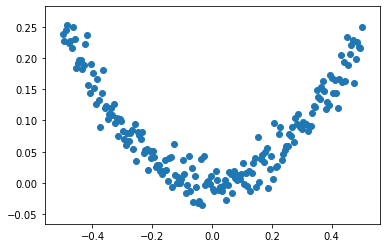

In [17]:
# 显示随机点
plt.scatter(x_data,y_data)
plt.show()

In [42]:
# 构建一个顺序模型
model = Sequential()
# 在模型中添加一个全连接层
# 1-10-1
model.add(Dense(units=10,input_shape=(1, ),activation='relu'))
# model.add(Activation('tanh'))
model.add(Dense(units=1,activation='tanh'))
# model.add(Activation('tanh'))
# 定义优化算法
sgd = SGD(lr=0.02)
# sgd:Stochastic gradient descent，随机梯度下降法
# mse:Mean Squared Error，均方误差

model.compile(optimizer=sgd,loss='mse')

# 训练3001个批次
for step in range(20001):
    # 每次训练一个批次
    cost = model.train_on_batch(x_data,y_data)
    # 每500个batch打印一次cost值
    if step % 4000 == 0:
        print('cost:',cost)

# x_data输入网络中，得到预测值y_pred
y_pred = model.predict(x_data)

cost: 0.0297736
cost: 0.0006117935
cost: 0.00049157673
cost: 0.00044833389
cost: 0.00042968817
cost: 0.00041972884


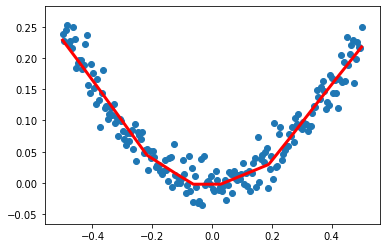

In [43]:
# 显示随机点
plt.scatter(x_data,y_data)
# 显示预测结果
plt.plot(x_data,y_pred,'r-',lw=3)
plt.show()

# 分类

## MNIST数据集分类bp(dropout, l2, adam)

In [19]:
import numpy as np
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense,Dropout
from keras.optimizers import SGD, Adam
from keras.regularizers import l2

In [23]:
#from keras.datasets import mnist

f = np.load('mnist.npz') 
x_train, y_train = f['x_train'], f['y_train']  
x_test, y_test = f['x_test'], f['y_test']  
f.close() 
# 载入数据
#(x_train,y_train),(x_test,y_test) = mnist.load_data()
# (60000,28,28)
print('x_shape:',x_train.shape)
# (60000)
print('y_shape:',y_train.shape)

x_shape: (60000, 28, 28)
y_shape: (60000,)


In [24]:
# (60000,28,28)->(60000,784) & 线性归一化
x_train = x_train.reshape(x_train.shape[0],-1)/255.0
x_test = x_test.reshape(x_test.shape[0],-1)/255.0
# 换one hot格式
y_train = np_utils.to_categorical(y_train,num_classes=10)
y_test = np_utils.to_categorical(y_test,num_classes=10)

# 创建模型，输入784个神经元，输出10个神经元
model = Sequential()
model.add(Dense(units=100,input_shape=(784, ),bias_initializer='one',activation='relu',kernel_regularizer=l2(0.003)))
model.add(Dropout(0.5))
model.add(Dense(units=10,activation='softmax'))

# 定义优化器
sgd = SGD(lr=0.2)
adam = Adam(lr=0.001)

# 定义优化器，loss function，训练过程中计算准确率
model.compile(
    optimizer = adam,
    loss = 'categorical_crossentropy',
    metrics=['accuracy'],
)

# 训练模型
model.fit(x_train,y_train,batch_size=64,epochs=10)

# 评估模型
loss,accuracy = model.evaluate(x_test,y_test)

print('\ntest loss',loss)
print('accuracy',accuracy)

Epoch 1/10
60000/60000 [==============================] - 2s 39us/step - loss: 0.7657 - acc: 0.8369
Epoch 2/10
60000/60000 [==============================] - 2s 33us/step - loss: 0.4994 - acc: 0.8933:
Epoch 3/10
60000/60000 [==============================] - 2s 36us/step - loss: 0.4519 - acc: 0.9060
Epoch 4/10
60000/60000 [==============================] - 2s 33us/step - loss: 0.4342 - acc: 0.9101
Epoch 5/10
60000/60000 [==============================] - 2s 33us/step - loss: 0.4155 - acc: 0.9144
Epoch 6/10
60000/60000 [==============================] - 2s 33us/step - loss: 0.4013 - acc: 0.9163
Epoch 7/10
60000/60000 [==============================] - 2s 36us/step - loss: 0.3893 - acc: 0.9205
Epoch 8/10
60000/60000 [==============================] - 2s 36us/step - loss: 0.3793 - acc: 0.9228
Epoch 9/10
60000/60000 [==============================] - 2s 36us/step - loss: 0.3699 - acc: 0.9243
Epoch 10/10
10000/10000 [==============================] - 0s 29us/step

test loss 0.25732917633056

## cnn完成cifar10分类

http://www.cs.toronto.edu/~kriz/cifar.html
The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. There are 50000 training images and 10000 test images. 
Here are the classes in the dataset:
airplane										
automobile										
bird										
cat										
deer										
dog										
frog										
horse										
ship										
truck

In [25]:
from keras.datasets import cifar10
import numpy as np
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense,Dropout,Convolution2D,MaxPooling2D,Flatten
from keras.optimizers import Adam

In [26]:
(x_train,y_train),(x_test,y_test)=cifar10.load_data()

170500096/170498071 [==============================] - 560s 3us/step


In [27]:
type(x_train)

numpy.ndarray

In [28]:
x_train.shape,y_train.shape,x_test.shape,y_test.shape

((50000, 32, 32, 3), (50000, 1), (10000, 32, 32, 3), (10000, 1))

In [29]:
#归一化
x_train = x_train/255.0
x_test = x_test/255.0
# 换one hot格式
y_train = np_utils.to_categorical(y_train,num_classes=10)
y_test = np_utils.to_categorical(y_test,num_classes=10)

In [30]:
# 定义顺序模型
model = Sequential()

# 第一个卷积层
# input_shape 输入平面
# filters 卷积核/滤波器个数
# kernel_size 卷积窗口大小
# strides 步长
# padding padding方式 same/valid
# activation 激活函数
model.add(Convolution2D(
    input_shape = (32,32,3),
    filters = 32,
    kernel_size = 5,
    strides = 1,
    padding = 'same',
    activation = 'relu'
))
# 第一个池化层
model.add(MaxPooling2D(
    pool_size = 2,
    strides = 2,
    padding = 'same',
))
# 第二个卷积层
model.add(Convolution2D(64,5,strides=1,padding='same',activation = 'relu'))
# 第二个池化层
model.add(MaxPooling2D(2,2,'same'))
# 把第二个池化层的输出扁平化为1维
model.add(Flatten())
# 第一个全连接层
model.add(Dense(1024,activation = 'relu'))
# Dropout
model.add(Dropout(0.5))
# 第二个全连接层
model.add(Dense(10,activation='softmax'))

# 定义优化器
adam = Adam(lr=1e-4)

# 定义优化器，loss function，训练过程中计算准确率
model.compile(optimizer=adam,loss='categorical_crossentropy',metrics=['accuracy'])

W1204 11:55:14.770327 140735940825984 deprecation_wrapper.py:119] From /Users/luoyonggui/anaconda3/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.



In [31]:
# 训练模型
model.fit(x_train,y_train,batch_size=600,epochs=10)

Epoch 1/10
50000/50000 [==============================] - 78s 2ms/step - loss: 1.9723 - acc: 0.2969
Epoch 2/10
50000/50000 [==============================] - 80s 2ms/step - loss: 1.6634 - acc: 0.4125
Epoch 3/10
50000/50000 [==============================] - 76s 2ms/step - loss: 1.5478 - acc: 0.4517
Epoch 4/10
50000/50000 [==============================] - 74s 1ms/step - loss: 1.4652 - acc: 0.4806
Epoch 5/10
50000/50000 [==============================] - 74s 1ms/step - loss: 1.4013 - acc: 0.5063
Epoch 6/10
50000/50000 [==============================] - 72s 1ms/step - loss: 1.3488 - acc: 0.5259
Epoch 7/10
50000/50000 [==============================] - 72s 1ms/step - loss: 1.3076 - acc: 0.5410
Epoch 8/10
50000/50000 [==============================] - 72s 1ms/step - loss: 1.2676 - acc: 0.5559
Epoch 9/10
50000/50000 [==============================] - 70s 1ms/step - loss: 1.2401 - acc: 0.5642
Epoch 10/10
50000/50000 [==============================] - 70s 1ms/step - loss: 1.2063 - acc: 0.5778

In [32]:
# 评估模型
loss,accuracy = model.evaluate(x_test,y_test)

print('test loss',loss)
print('test accuracy',accuracy)

10000/10000 [==============================] - 5s 533us/step
test loss 1.1805831954956054
test accuracy 0.5884


## minst_SimpleRNN

In [33]:
import numpy as np
from keras.datasets import mnist
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense
from keras.layers.recurrent import SimpleRNN
from keras.optimizers import Adam

In [34]:
# 数据长度-一行有28个像素
input_size = 28
# 序列长度-一共有28行
time_steps = 28
# 隐藏层cell个数
cell_size = 50 

# 载入数据
(x_train,y_train),(x_test,y_test) = mnist.load_data()
# (60000,28,28)
x_train = x_train/255.0
x_test = x_test/255.0
# 换one hot格式
y_train = np_utils.to_categorical(y_train,num_classes=10)
y_test = np_utils.to_categorical(y_test,num_classes=10)#one hot

# 创建模型
model = Sequential()

# 循环神经网络
model.add(SimpleRNN(
    units = cell_size, # 输出
    input_shape = (time_steps,input_size), #输入
))

# 输出层
model.add(Dense(10,activation='softmax'))

# 定义优化器
adam = Adam(lr=1e-4)

# 定义优化器，loss function，训练过程中计算准确率
model.compile(optimizer=adam,loss='categorical_crossentropy',metrics=['accuracy'])

# 训练模型
model.fit(x_train,y_train,batch_size=64,epochs=10)

# 评估模型
loss,accuracy = model.evaluate(x_test,y_test)

print('test loss',loss)
print('test accuracy',accuracy)

Epoch 1/10
60000/60000 [==============================] - 6s 93us/step - loss: 1.4762 - acc: 0.5435
Epoch 2/10
60000/60000 [==============================] - 5s 87us/step - loss: 0.7993 - acc: 0.7772
Epoch 3/10
60000/60000 [==============================] - 5s 86us/step - loss: 0.6039 - acc: 0.8262
Epoch 4/10
60000/60000 [==============================] - 5s 87us/step - loss: 0.5010 - acc: 0.8550
Epoch 5/10
60000/60000 [==============================] - 5s 87us/step - loss: 0.4353 - acc: 0.8743
Epoch 6/10
60000/60000 [==============================] - 5s 86us/step - loss: 0.3911 - acc: 0.8878
Epoch 7/10
60000/60000 [==============================] - 5s 86us/step - loss: 0.3602 - acc: 0.8961: 0s - loss: 0.3617 - acc
Epoch 8/10
60000/60000 [==============================] - 5s 86us/step - loss: 0.3350 - acc: 0.9033
Epoch 9/10
60000/60000 [==============================] - 5s 87us/step - loss: 0.3150 - acc: 0.9094
Epoch 10/10
10000/10000 [==============================] - 1s 66us/step
tes

## 猫狗分类vgg16

第一种方法是直接新建一个cnn，从零开始训练，50个epoch后准确率约0.78

第二种方法首先通过vgg16来抽取图片特征，然后把这些特征作为输入 到一个简单的bp神经网络，20个epoch后准确率约0.856

第三种方法把vgg16作为网络的一部分+一个简单的bp，finetune，70个epoch后准确率约0.94

### ResNet50，InceptionV3，VGG19的载入方式

In [ ]:
ResNet50_model = ResNet50(weights='imagenet', include_top=False, input_shape=(150,150,3))
InceptionV3_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(150,150,3))
VGG19_model = VGG19(weights='imagenet', include_top=False, input_shape=(150,150,3))

### 图片预处理

链接：https://pan.baidu.com/s/1i4SKqWH 密码：d8mt

In [1]:
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

Using TensorFlow backend.


* rotation_range是一个0~180的度数，用来指定随机选择图片的角度。  
* width_shift和height_shift用来指定水平和竖直方向随机移动的程度，这是两个0~1之间的比  
* rescale值将在执行其他处理前乘到整个图像上，我们的图像在RGB通道都是0~255的整数，这样的操作可能使图像的值过高或过低，所以我们将这个值定为0~1之间的数。  
* shear_range是用来进行剪切变换的程度，参考剪切变换  
* zoom_range用来进行随机的放大  
* horizontal_flip随机的对图片进行水平翻转，这个参数适用于水平翻转不影响图片语义的时候  
* fill_mode用来指定当需要进行像素填充，如旋转，水平和竖直位移时，如何填充新出现的像素  

In [2]:
datagen = ImageDataGenerator(
        rotation_range = 40,      # 随机旋转角度
        width_shift_range = 0.2,  # 随机水平平移
        height_shift_range = 0.2, # 随机竖直平移
        rescale = 1./255,         # 数值归一化
        shear_range = 0.2,        # 随机裁剪
        zoom_range  =0.2,         # 随机放大
        horizontal_flip = True,   # 水平翻转
        fill_mode='nearest')      # 填充方式

In [4]:
# 载入图片
img = load_img('image/train/cat/cat.1.jpg')
x = img_to_array(img) 
print(x.shape)
x = x.reshape((1,) + x.shape)
print(x.shape)

(280, 300, 3)
(1, 280, 300, 3)


In [5]:
i = 0
# 生成21张图片
# flow 随机生成图片
for batch in datagen.flow(x, batch_size=1, save_to_dir='temp', save_prefix='cat', save_format='jpeg'): 
    # 执行21次
    i += 1
    if i > 20:
        break 

### vgg16抽取特征，然后再用一个神经网络训练

In [ ]:
from keras.applications.vgg16 import VGG16
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense
from keras.optimizers import Adam

In [59]:
# 载入预训练的VGG16模型，不包括全连接层
model = VGG16(weights='imagenet', include_top=False)

In [60]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         (None, None, None, 3)     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0         
__________

In [47]:
datagen = ImageDataGenerator(
        rotation_range = 40,      # 随机旋转角度
        width_shift_range = 0.2,  # 随机水平平移
        height_shift_range = 0.2, # 随机竖直平移
        rescale = 1./255,         # 数值归一化
        shear_range = 0.2,        # 随机裁剪
        zoom_range  =0.2,         # 随机放大
        horizontal_flip = True,   # 水平翻转
        fill_mode='nearest')      # 填充方式

flow_from_directory:  
* directory: 目标文件夹路径,对于每一个类,该文件夹都要包含一个子文件夹.子文件夹中任何JPG、PNG、BNP、PPM的图片都会被生成器使用.详情请查看此脚本  
* target_size: 整数tuple,默认为(256, 256). 图像将被resize成该尺寸  
* color_mode: 颜色模式,为"grayscale","rgb"之一,默认为"rgb".代表这些图片是否会被转换为单通道或三通道的图片.  
* classes: 可选参数,为子文件夹的列表,如['dogs','cats']默认为None. 若未提供,则该类别列表将从directory下的子文件夹名称/结构自动推断。每一个子文件夹都会被认为是一个新的类。(类别的顺序将按照字母表顺序映射到标签值)。通过属性class_indices可获得文件夹名与类的序号的对应字典。  
* class_mode: "categorical", "binary", "sparse"或None之一. 默认为"categorical. 该参数决定了返回的标签数组的形式, "categorical"会返回2D的one-hot编码标签,"binary"返回1D的二值标签."sparse"返回1D的整数标签,如果为None则不返回任何标签, 生成器将仅仅生成batch数据, 这种情况在使用model.predict_generator()和model.evaluate_generator()等函数时会用到.  
* batch_size: batch数据的大小,默认32  
* shuffle: 是否打乱数据,默认为True  
* seed: 可选参数,打乱数据和进行变换时的随机数种子  
* save_to_dir: None或字符串，该参数能让你将提升后的图片保存起来，用以可视化  
* save_prefix：字符串，保存提升后图片时使用的前缀, 仅当设置了save_to_dir时生效  
* save_format："png"或"jpeg"之一，指定保存图片的数据格式,默认"jpeg"  
* flollow_links: 是否访问子文件夹中的软链接  

In [48]:
batch_size = 32
# 
train_steps = int((2000 +  batch_size - 1)/batch_size)*10
test_steps = int((1000 +  batch_size - 1)/batch_size)*10
generator = datagen.flow_from_directory(
        'image/train',
        target_size=(150, 150),
        batch_size=batch_size,
        class_mode=None,  # 不生成标签
        shuffle=False)    # 不随机打乱

# 得到训练集数据
bottleneck_features_train = model.predict_generator(generator, train_steps)
print(bottleneck_features_train.shape)
# 保存训练集bottleneck结果
np.save(open('bottleneck_features_train.npy', 'wb'), bottleneck_features_train)

generator = datagen.flow_from_directory(
        'image/test',
        target_size=(150, 150),
        batch_size=batch_size,
        class_mode=None, # 不生成标签
        shuffle=False)  # 不随机打乱
# 得到预测集数据
bottleneck_features_test = model.predict_generator(generator, test_steps)
print(bottleneck_features_test.shape)
# 保存测试集bottleneck结果
np.save(open('bottleneck_features_test.npy', 'wb'), bottleneck_features_test)

Found 2000 images belonging to 2 classes.
(20000, 4, 4, 512)
Found 1000 images belonging to 2 classes.
(10000, 4, 4, 512)


In [50]:
train_data = np.load(open('bottleneck_features_train.npy','rb'))
# the features were saved in order, so recreating the labels is easy
labels = np.array([0] * 1000 + [1] * 1000)
train_labels = np.array([])
for _ in range(10):
    train_labels=np.concatenate((train_labels,labels))

test_data = np.load(open('bottleneck_features_test.npy','rb'))
labels = np.array([0] * 500 + [1] * 500)
test_labels = np.array([])
for _ in range(10):
    test_labels=np.concatenate((test_labels,labels))

train_labels = np_utils.to_categorical(train_labels,num_classes=2)
test_labels = np_utils.to_categorical(test_labels,num_classes=2)

In [56]:
model = Sequential()
model.add(Flatten(input_shape=train_data.shape[1:]))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(2, activation='softmax'))

# 定义优化器
adam = Adam(lr=1e-4)

# 定义优化器，loss function，训练过程中计算准确率
model.compile(optimizer=adam,loss='categorical_crossentropy',metrics=['accuracy'])

model.fit(train_data, train_labels,
          epochs=20, batch_size=batch_size,
          validation_data=(test_data, test_labels))

model.save_weights('bottleneck_fc_model.h5')

Train on 20000 samples, validate on 10000 samples
Epoch 1/20
20000/20000 [==============================] - 9s - loss: 0.4213 - acc: 0.8006 - val_loss: 0.3432 - val_acc: 0.8477
Epoch 2/20
20000/20000 [==============================] - 9s - loss: 0.3117 - acc: 0.8632 - val_loss: 0.3290 - val_acc: 0.8551
Epoch 3/20
20000/20000 [==============================] - 9s - loss: 0.2711 - acc: 0.8828 - val_loss: 0.3301 - val_acc: 0.8526
Epoch 4/20
20000/20000 [==============================] - 9s - loss: 0.2405 - acc: 0.8985 - val_loss: 0.3297 - val_acc: 0.8574
Epoch 5/20
20000/20000 [==============================] - 8s - loss: 0.2120 - acc: 0.9114 - val_loss: 0.3396 - val_acc: 0.8582
Epoch 6/20
20000/20000 [==============================] - 9s - loss: 0.1895 - acc: 0.9216 - val_loss: 0.3429 - val_acc: 0.8572
Epoch 7/20
20000/20000 [==============================] - 9s - loss: 0.1681 - acc: 0.9319 - val_loss: 0.3522 - val_acc: 0.8563
Epoch 8/20
20000/20000 [==============================] - 8s 

In [62]:
len(model.layers)

19

## vgg16 fine tune直接把vgg16作为模型的一部分训练

In [ ]:
from keras.applications.vgg16 import VGG16
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense
from keras.optimizers import SGD
import os

In [2]:
# 载入预训练的VGG16模型，不包括全连接层
vgg16_model = VGG16(weights='imagenet', include_top=False, input_shape=(150,150,3))

In [3]:
# 搭建全连接层
top_model = Sequential()
top_model.add(Flatten(input_shape=vgg16_model.output_shape[1:]))
top_model.add(Dense(256, activation='relu'))
top_model.add(Dropout(0.5))
top_model.add(Dense(2, activation='softmax'))

# 载入训练过的权值
top_model.load_weights('bottleneck_fc_model.h5')

model = Sequential()
model.add(vgg16_model)
model.add(top_model)

In [4]:
# 训练集数据生成
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True)

# 测试集数据处理
test_datagen = ImageDataGenerator(rescale=1./255)

In [5]:
batch_size = 32
# 生成训练数据
train_generator = train_datagen.flow_from_directory(
        'image/train',  # 训练数据路径
        target_size=(150, 150),  # 设置图片大小
        batch_size=batch_size # 批次大小
        ) 

# 测试数据
test_generator = test_datagen.flow_from_directory(
        'image/test',  # 训练数据路径
        target_size=(150, 150),  # 设置图片大小
        batch_size=batch_size # 批次大小
        )

Found 2000 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


In [6]:
model.compile(loss='categorical_crossentropy',
              optimizer=SGD(lr=1e-4, momentum=0.9),
              metrics=['accuracy'])


# 统计文件个数
totalFileCount = sum([len(files) for root, dirs, files in os.walk('image/train')])

model.fit_generator(
        train_generator,
        steps_per_epoch=totalFileCount/batch_size,
        epochs=10,
        validation_data=test_generator,
        validation_steps=1000/batch_size,
        )

Epoch 1/50
63/62 [==============================] - 136s - loss: 0.2505 - acc: 0.9196 - val_loss: 0.2805 - val_acc: 0.9021
Epoch 2/50
63/62 [==============================] - 118s - loss: 0.1046 - acc: 0.9563 - val_loss: 0.2127 - val_acc: 0.9228
Epoch 3/50
63/62 [==============================] - 118s - loss: 0.0725 - acc: 0.9792 - val_loss: 0.2039 - val_acc: 0.9304
Epoch 4/50
63/62 [==============================] - 118s - loss: 0.0740 - acc: 0.9678 - val_loss: 0.2118 - val_acc: 0.9258
Epoch 5/50
63/62 [==============================] - 118s - loss: 0.0629 - acc: 0.9777 - val_loss: 0.1960 - val_acc: 0.9375
Epoch 6/50
63/62 [==============================] - 118s - loss: 0.0564 - acc: 0.9807 - val_loss: 0.2109 - val_acc: 0.9304
Epoch 7/50
63/62 [==============================] - 118s - loss: 0.0451 - acc: 0.9821 - val_loss: 0.2611 - val_acc: 0.9299
Epoch 8/50
63/62 [==============================] - 118s - loss: 0.0387 - acc: 0.9856 - val_loss: 0.2099 - val_acc: 0.9365
Epoch 9/50
63/62

## 双向LSTM做中文分词

In [1]:
# -*- coding:utf-8 -*-
import re
import numpy as np
import pandas as pd

# 
text = open('msr_train_10.txt').read()
text = text.split('\n')

In [2]:
len(text)

10

In [3]:
# {B:begin, M:middle, E:end, S:single}，分别代表每个状态代表的是该字在词语中的位置，
# B代表该字是词语中的起始字，M代表是词语中的中间字，E代表是词语中的结束字，S则代表是单字成词
text

['“/s  人/b  们/e  常/s  说/s  生/b  活/e  是/s  一/s  部/s  教/b  科/m  书/e  ，/s  而/s  血/s  与/s  火/s  的/s  战/b  争/e  更/s  是/s  不/b  可/m  多/m  得/e  的/s  教/b  科/m  书/e  ，/s  她/s  确/b  实/e  是/s  名/b  副/m  其/m  实/e  的/s  ‘/s  我/s  的/s  大/b  学/e  ’/s  。/s  ',
 '“/s  心/s  静/s  渐/s  知/s  春/s  似/s  海/s  ，/s  花/s  深/s  每/s  觉/s  影/s  生/s  香/s  。/s  ',
 '“/s  吃/s  屎/s  的/s  东/b  西/e  ，/s  连/s  一/s  捆/s  麦/s  也/s  铡/s  不/s  动/s  呀/s  ？/s  ',
 '他/s  “/s  严/b  格/m  要/m  求/e  自/b  己/e  ，/s  从/s  一/b  个/e  科/b  举/e  出/b  身/e  的/s  进/b  士/e  成/b  为/e  一/b  个/e  伟/b  大/e  的/s  民/b  主/m  主/m  义/e  者/s  ，/s  进/b  而/e  成/b  为/e  一/s  位/s  杰/b  出/e  的/s  党/b  外/e  共/b  产/m  主/m  义/e  战/b  士/e  ，/s  献/b  身/e  于/s  崇/b  高/e  的/s  共/b  产/m  主/m  义/e  事/b  业/e  。/s  ',
 '“/s  征/s  而/s  未/s  用/s  的/s  耕/b  地/e  和/s  有/s  收/b  益/e  的/s  土/b  地/e  ，/s  不/b  准/e  荒/b  芜/e  。/s  ',
 '“/s  这/s  首/b  先/e  是/s  个/s  民/b  族/e  问/b  题/e  ，/s  民/b  族/e  的/s  感/b  情/e  问/b  题/e  。/s  ',
 '’/s  我/s  扔/s  了/s  两/b  颗/e  手/b  榴/m  弹/e

In [4]:
# 设置参数
# 词向量长度
word_size = 128
# 设置最长的一句话为32个字
maxlen = 32
# 批次大小
batch_size = 1024

# 根据符号分句
text = u''.join( text)
text = re.split(u'[，。！？、]/[bems]', text)

In [5]:
len(text)

25

In [6]:
text

['“/s  人/b  们/e  常/s  说/s  生/b  活/e  是/s  一/s  部/s  教/b  科/m  书/e  ',
 '  而/s  血/s  与/s  火/s  的/s  战/b  争/e  更/s  是/s  不/b  可/m  多/m  得/e  的/s  教/b  科/m  书/e  ',
 '  她/s  确/b  实/e  是/s  名/b  副/m  其/m  实/e  的/s  ‘/s  我/s  的/s  大/b  学/e  ’/s  ',
 '  “/s  心/s  静/s  渐/s  知/s  春/s  似/s  海/s  ',
 '  花/s  深/s  每/s  觉/s  影/s  生/s  香/s  ',
 '  “/s  吃/s  屎/s  的/s  东/b  西/e  ',
 '  连/s  一/s  捆/s  麦/s  也/s  铡/s  不/s  动/s  呀/s  ',
 '  他/s  “/s  严/b  格/m  要/m  求/e  自/b  己/e  ',
 '  从/s  一/b  个/e  科/b  举/e  出/b  身/e  的/s  进/b  士/e  成/b  为/e  一/b  个/e  伟/b  大/e  的/s  民/b  主/m  主/m  义/e  者/s  ',
 '  进/b  而/e  成/b  为/e  一/s  位/s  杰/b  出/e  的/s  党/b  外/e  共/b  产/m  主/m  义/e  战/b  士/e  ',
 '  献/b  身/e  于/s  崇/b  高/e  的/s  共/b  产/m  主/m  义/e  事/b  业/e  ',
 '  “/s  征/s  而/s  未/s  用/s  的/s  耕/b  地/e  和/s  有/s  收/b  益/e  的/s  土/b  地/e  ',
 '  不/b  准/e  荒/b  芜/e  ',
 '  “/s  这/s  首/b  先/e  是/s  个/s  民/b  族/e  问/b  题/e  ',
 '  民/b  族/e  的/s  感/b  情/e  问/b  题/e  ',
 '  ’/s  我/s  扔/s  了/s  两/b  颗/e  手/b  榴/m  弹/e

In [7]:
# 训练集数据
data = []
# 标签
label = []

# 得到所有的数据和标签
def get_data(s):
    s = re.findall('(.)/(.)', s)
    if s:
        s = np.array(s)
        # 返回数据和标签，0为数据，1为标签
        return list(s[:,0]), list(s[:,1])

for s in text:
    d = get_data(s)
    if d:
        data.append(d[0])
        label.append(d[1])

In [8]:
test = re.findall('(.)/(.)', '你/s  只/b  有/e  把/s  事/b  情/e  做/b  好/e')
test

[('你', 's'),
 ('只', 'b'),
 ('有', 'e'),
 ('把', 's'),
 ('事', 'b'),
 ('情', 'e'),
 ('做', 'b'),
 ('好', 'e')]

In [9]:
# 定义一个dataframe存放数据和标签
d = pd.DataFrame(index=range(len(data)))
d['data'] = data
d['label'] = label
# 提取data长度小于等于maxlen的数据
d = d[d['data'].apply(len) <= maxlen]
# 重新排列index
d.index = range(len(d))

In [10]:
d

,data,label
0,"[“, 人, 们, 常, 说, 生, 活, 是, 一, 部, 教, 科, 书]","[s, b, e, s, s, b, e, s, s, s, b, m, e]"
1,"[而, 血, 与, 火, 的, 战, 争, 更, 是, 不, 可, 多, 得, 的, 教, ...","[s, s, s, s, s, b, e, s, s, b, m, m, e, s, b, ..."
2,"[她, 确, 实, 是, 名, 副, 其, 实, 的, ‘, 我, 的, 大, 学, ’]","[s, b, e, s, b, m, m, e, s, s, s, s, b, e, s]"
3,"[“, 心, 静, 渐, 知, 春, 似, 海]","[s, s, s, s, s, s, s, s]"
4,"[花, 深, 每, 觉, 影, 生, 香]","[s, s, s, s, s, s, s]"
5,"[“, 吃, 屎, 的, 东, 西]","[s, s, s, s, b, e]"
6,"[连, 一, 捆, 麦, 也, 铡, 不, 动, 呀]","[s, s, s, s, s, s, s, s, s]"
7,"[他, “, 严, 格, 要, 求, 自, 己]","[s, s, b, m, m, e, b, e]"
8,"[从, 一, 个, 科, 举, 出, 身, 的, 进, 士, 成, 为, 一, 个, 伟, ...","[s, b, e, b, e, b, e, s, b, e, b, e, b, e, b, ..."
9,"[进, 而, 成, 为, 一, 位, 杰, 出, 的, 党, 外, 共, 产, 主, 义, ...","[b, e, b, e, s, s, b, e, s, b, e, b, m, m, e, ..."


In [11]:
#统计所有字，给每个字编号
chars = [] 
for i in data:
    chars.extend(i)

chars = pd.Series(chars).value_counts()

In [12]:
chars

的    14
“     9
一     6
主     5
是     5
有     5
义     4
不     4
个     4
产     3
我     3
而     3
民     3
出     3
大     3
共     3
科     3
战     2
书     2
跟     2
为     2
进     2
族     2
接     2
你     2
问     2
’     2
没     2
也     2
题     2
     ..
才     1
要     1
具     1
两     1
活     1
连     1
溜     1
名     1
扔     1
动     1
原     1
业     1
部     1
火     1
把     1
伟     1
海     1
捆     1
觉     1
求     1
常     1
和     1
只     1
影     1
系     1
己     1
与     1
在     1
静     1
外     1
dtype: int64

In [13]:
chars[:] = range(1, len(chars)+1)
chars

的      1
“      2
一      3
主      4
是      5
有      6
义      7
不      8
个      9
产     10
我     11
而     12
民     13
出     14
大     15
共     16
科     17
战     18
书     19
跟     20
为     21
进     22
族     23
接     24
你     25
问     26
’     27
没     28
也     29
题     30
    ... 
才    132
要    133
具    134
两    135
活    136
连    137
溜    138
名    139
扔    140
动    141
原    142
业    143
部    144
火    145
把    146
伟    147
海    148
捆    149
觉    150
求    151
常    152
和    153
只    154
影    155
系    156
己    157
与    158
在    159
静    160
外    161
dtype: int32

In [14]:
#生成适合模型输入的格式
from keras.utils import np_utils

# 定义标签所对应的编号
tag = pd.Series({'s':0, 'b':1, 'm':2, 'e':3, 'x':4})

# # 把中文变成编号，再补0
# d['x'] = d['data'].apply(lambda x: np.array(list(chars[x])+[0]*(maxlen-len(x))))
# # 把标签变成编号，再补0
# d['y'] = d['label'].apply(lambda x: np.array(list(map(lambda y:np_utils.to_categorical(y,5), tag[x].reshape((-1,1))))+[np.array([[0,0,0,0,1]])]*(maxlen-len(x))))


def data_helper(x):
    x = list(chars[x]) + [0]*(maxlen-len(x))
    return np.array(x)     

def label_helper(x):
    x = list(map(lambda y:np_utils.to_categorical(y,5), tag[x].reshape((-1,1))))
    x = x + [np.array([[0,0,0,0,1]])]*(maxlen-len(x))
    return np.array(x) 
    
d['x'] = d['data'].apply(data_helper) 
d['y'] = d['label'].apply(label_helper)    

Using TensorFlow backend.


In [15]:
d['data'][0]

['“', '人', '们', '常', '说', '生', '活', '是', '一', '部', '教', '科', '书']

In [16]:
d['x'][0]

array([  2, 130,  50, 152,  98,  51, 136,   5,   3, 144,  34,  17,  19,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0])

In [17]:
d['label'][0]

['s', 'b', 'e', 's', 's', 'b', 'e', 's', 's', 's', 'b', 'm', 'e']

In [18]:
d['y'][0]

array([[[1., 0., 0., 0., 0.]],

       [[0., 1., 0., 0., 0.]],

       [[0., 0., 0., 1., 0.]],

       [[1., 0., 0., 0., 0.]],

       [[1., 0., 0., 0., 0.]],

       [[0., 1., 0., 0., 0.]],

       [[0., 0., 0., 1., 0.]],

       [[1., 0., 0., 0., 0.]],

       [[1., 0., 0., 0., 0.]],

       [[1., 0., 0., 0., 0.]],

       [[0., 1., 0., 0., 0.]],

       [[0., 0., 1., 0., 0.]],

       [[0., 0., 0., 1., 0.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [[0., 0., 0., 0., 1.]],

       [

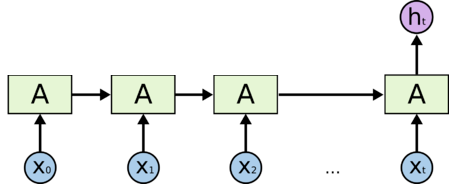

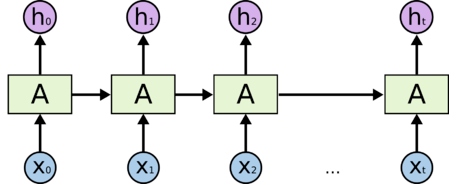

In [19]:
# 设计模型
from keras.layers import Dense, Embedding, LSTM, TimeDistributed, Input, Bidirectional
from keras.models import Model
from keras.models import load_model

sequence = Input(shape=(maxlen,), dtype='int32')
# 词汇数，词向量长度，输入的序列长度，是否忽略0值
embedded = Embedding(len(chars)+1, word_size, input_length=maxlen, mask_zero=True)(sequence)
# 双向RNN包装器
blstm = Bidirectional(LSTM(64, return_sequences=True), merge_mode='sum')(embedded)
# 该包装器可以把一个层应用到输入的每一个时间步上
output = TimeDistributed(Dense(5, activation='softmax'))(blstm)
# 定义模型输出输出
model = Model(inputs=sequence, outputs=output)
# 定义代价函数，优化器
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])


# print(np.array(list(d['x'])).shape)
# print(np.array(list(d['y'])).reshape((-1,maxlen,5)).shape)
# model.fit(np.array(list(d['x'])), np.array(list(d['y'])).reshape((-1,maxlen,5)), batch_size=batch_size, epochs=20)
# model.save('seq2seq.h5')

print("load model")
model = load_model('seq2seq.h5')

load model


In [20]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 32)                0         
_________________________________________________________________
embedding_1 (Embedding)      (None, 32, 128)           660864    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 32, 64)            98816     
_________________________________________________________________
time_distributed_1 (TimeDist (None, 32, 5)             325       
Total params: 760,005
Trainable params: 760,005
Non-trainable params: 0
_________________________________________________________________


做预测

In [21]:
# 使用全数据
text = open('msr_train.txt').read()
text = text.split('\n')

# 根据符号分句
text = u''.join(text)
text = re.split(u'[，。！？、]/[bems]', text)

# 训练集数据
data = []
# 标签
label = []

# 得到所有的数据和标签
def get_data(s):
    s = re.findall('(.)/(.)', s)
    if s:
        s = np.array(s)
        # 返回数据和标签，0为数据，1为标签
        return list(s[:,0]), list(s[:,1])

for s in text:
    d = get_data(s)
    if d:
        data.append(d[0])
        label.append(d[1])
        
# 定义一个dataframe存放数据和标签
d = pd.DataFrame(index=range(len(data)))
d['data'] = data
d['label'] = label
# 提取data长度小于等于maxlen的数据
d = d[d['data'].apply(len) <= maxlen]
# 重新排列index
d.index = range(len(d))

#统计所有字，给每个字编号
chars = [] 
for i in data:
    chars.extend(i)

chars = pd.Series(chars).value_counts()
chars[:] = range(1, len(chars)+1)

In [22]:
# 统计状态转移
dict_label = {}
for label in d['label']:
    for i in range(len(label)-1):
        tag = label[i] + label[i+1]
        dict_label[tag] = dict_label.get(tag,0) + 1
print(dict_label)

{'eb': 528062, 'be': 949884, 'ss': 266154, 'sb': 412351, 'es': 378288, 'mm': 170711, 'bm': 183969, 'me': 183974}


In [23]:
# 计算状态转移总次数
sum_num = 0
for value in dict_label.values():
    sum_num = sum_num + value
sum_num

3073393

In [24]:
# 计算状态转移概率
p_ss = dict_label['ss']/sum_num
p_sb = dict_label['sb']/sum_num
p_bm = dict_label['bm']/sum_num
p_be = dict_label['be']/sum_num
p_mm = dict_label['mm']/sum_num
p_me = dict_label['me']/sum_num
p_es = dict_label['es']/sum_num
p_eb = dict_label['eb']/sum_num

In [25]:
# 维特比算法，维特比算法是一种动态规划算法用于寻找最有可能产生观测事件序列的-维特比路径

# tag = pd.Series({'s':0, 'b':1, 'm':2, 'e':3, 'x':4})

# 00 = ss = 1
# 01 = sb = 1
# 02 = sm = 0
# 03 = se = 0
# 10 = bs = 0
# 11 = bb = 0
# 12 = bm = 1
# 13 = be = 1
# 20 = ms = 0
# 21 = mb = 0
# 22 = mm = 1
# 23 = me = 1
# 30 = es = 1
# 31 = eb = 1
# 32 = em = 0
# 33 = ee = 0

# 定义状态转移矩阵
transfer = [[p_ss,p_sb,0,0],
            [0,0,p_bm,p_be],
            [0,0,p_mm,p_me],
            [p_es,p_eb,0,0]]

# # 定义状态转移矩阵
# transfer = [[1,1,0,0],
#             [0,0,1,1],
#             [0,0,1,1],
#             [1,1,0,0]]

# 根据符号断句
cuts = re.compile(u'([\da-zA-Z ]+)|[。，、？！\.\?,!]')

# 预测分词
def predict(sentence):
    
    # 如果句子大于最大长度，只取maxlen个词
    if len(sentence) > maxlen:
        sentence = sentence[:maxlen]
    
    # 预测结果，先把句子编程编号的形式，如果出现生僻字就填充0，然后给句子补0直到maxlen的长度。预测得到的结果只保留跟句子有效数据相同的长度
    result = model.predict(np.array([list(chars[list(sentence)].fillna(0).astype(int))+[0]*(maxlen-len(sentence))]))[0][:len(sentence)]

    # 存放最终结果
    y = []
    # 存放临时概率值
    prob = []
    # 计算最大转移概率
    # 首先计算第1个词和第2个词,统计16种情况的概率
    # result[0][j]第1个词的标签概率
    # result[1][k]第2个词的标签概率
    # transfer[j][k]对应的转移概率矩阵的概率
    for j in range(4):
        for k in range(4):
            prob.append(result[0][j]*result[1][k]*transfer[j][k])
    # 计算前一个词的的标签
    word1 = np.argmax(prob)//4
    # 计算后一个词的标签
    word2 = np.argmax(prob)%4
    # 保存结果
    y.append(word1)
    y.append(word2)
    # 从第2个词开始
    for i in range(1,len(sentence)-1):
        # 存放临时概率值
        prob = []
        # 计算前一个词后后一个词的所有转移概率
        for j in range(4):
            prob.append(result[i][word2]*result[i+1][j]*transfer[word2][j])
        # 计算后一个词的标签
        word2 = np.argmax(prob)%4
        # 保存结果
        y.append(word2)
        
    # 分词
    words = []
    for i in range(len(sentence)):
        # 如果标签为s或b，append到结果的list中
        if y[i] in [0, 1]:
            words.append(sentence[i])
        else:
        # 如果标签为m或e，在list最后一个元素中追加内容
            words[-1] += sentence[i]
    return words

# 分词
def cut_word(s):
    result = []
    # 指针设置为0
    j = 0
    # 根据符号断句
    for i in cuts.finditer(s):
        # 对符号前的部分分词
        result.extend(predict(s[j:i.start()]))
        # 加入符号
        result.append(s[i.start():i.end()])
        # 移动指针到符号后面
        j = i.end()
    # 对最后的部分进行分词
    result.extend(predict(s[j:]))
    return result

In [26]:
cut_word('基于seq2seq的中文分词器')

['基于', 'seq2seq', '的', '中文', '分', '词器']

In [27]:
cut_word('人们常说生活是一部教科书')

['人们', '常说', '生活', '是', '一', '部', '教科书']

In [28]:
cut_word('广义相对论是描写物质间引力相互作用的理论')

['广义', '相对论', '是', '描写', '物', '质', '间', '引力', '相互', '作用', '的', '理论']

In [29]:
model.predict(np.array([list(chars[list('今天天气很好')].fillna(0).astype(int))+[0]*(maxlen-len('今天天气很好'))]))[0]

array([[5.3695333e-04, 9.9946302e-01, 2.5521592e-08, 4.3570618e-09,
        1.4844584e-09],
       [1.9184376e-04, 7.1968236e-07, 1.0082910e-06, 9.9980646e-01,
        2.5343561e-09],
       [1.1647578e-06, 9.9999511e-01, 3.7472551e-06, 4.4786855e-11,
        1.2289153e-11],
       [4.9465605e-05, 1.5763385e-10, 6.9671858e-04, 9.9925381e-01,
        4.1510535e-11],
       [9.9982244e-01, 1.7732578e-04, 1.8819671e-07, 1.0828031e-08,
        5.8034572e-10],
       [9.9905795e-01, 4.6581710e-07, 8.5055262e-08, 9.4140600e-04,
        1.6101223e-08],
       [1.4285019e-01, 2.0312425e-05, 9.3301540e-05, 8.5702705e-01,
        9.1915881e-06],
       [1.4285019e-01, 2.0312425e-05, 9.3301540e-05, 8.5702705e-01,
        9.1915881e-06],
       [1.4285019e-01, 2.0312425e-05, 9.3301540e-05, 8.5702705e-01,
        9.1915881e-06],
       [1.4285019e-01, 2.0312425e-05, 9.3301540e-05, 8.5702705e-01,
        9.1915881e-06],
       [1.4285019e-01, 2.0312425e-05, 9.3301540e-05, 8.5702705e-01,
        9.19

# 其它

## 图像风格转移

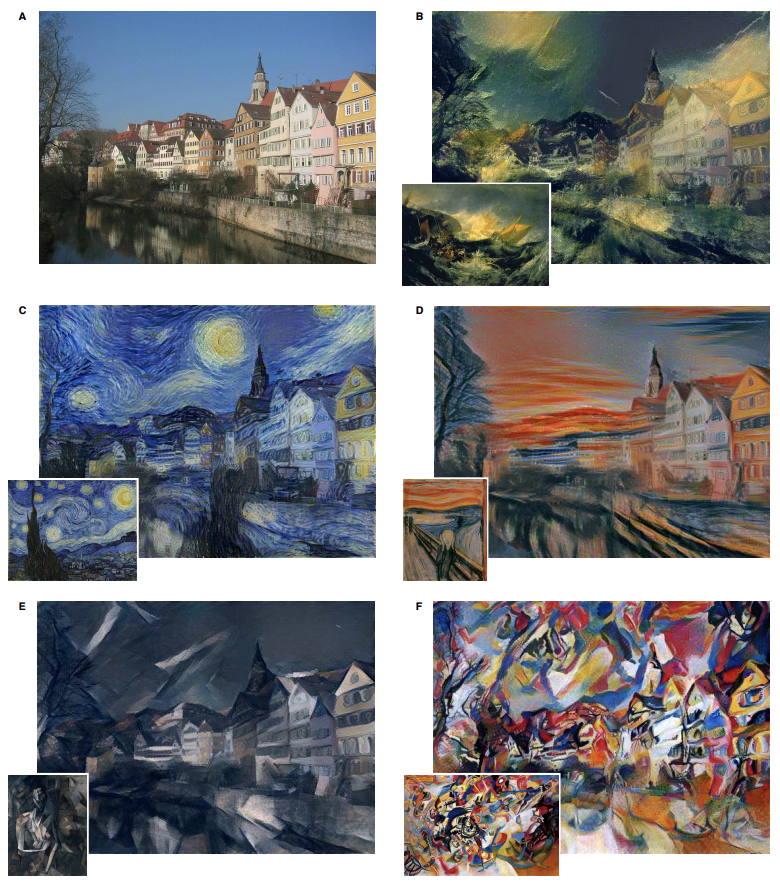 

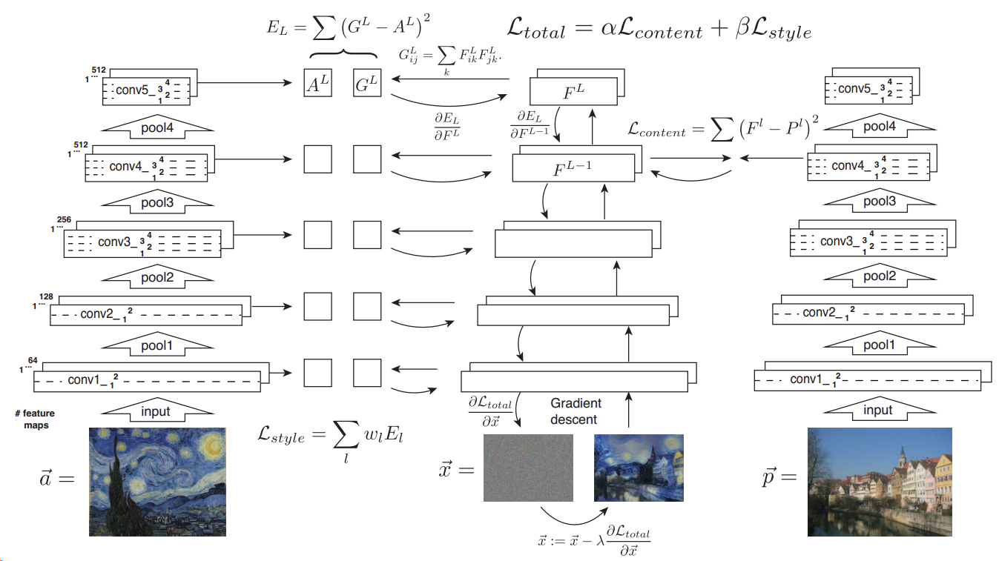

In [1]:
from keras.preprocessing.image import load_img, img_to_array
from scipy.misc import imsave
import numpy as np
from scipy.optimize import fmin_l_bfgs_b
import time
import matplotlib.pyplot as plt

from keras.applications import vgg16
# Keras并不处理如张量乘法、卷积等底层操作,需要调用backend
from keras import backend as K

C:\Users\Ian\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
# 设置参数
base_image_path = 'image/content/tubingen.jpg'
style_reference_image_path = 'image/style/starry_night.jpg'
result_prefix = 'image/output/output'
iterations = 30
total_variation_weight = 8.5e-5#对图片做平滑处理
style_weight = 1.0
content_weight = 0.025

# 设置产生图片的大小(将原来的图片进行等比缩放)
width, height = load_img(base_image_path).size
# 行
img_nrows = 200
# 列
img_ncols = int(width * img_nrows / height)

In [3]:
# 图片预处理
def preprocess_image(image_path):
    # 使用Keras内置函数读入图片并设置为指定长宽
    img = load_img(image_path, target_size=(img_nrows, img_ncols)) 
    # 转为numpy array格式
    img = img_to_array(img) 
    #：keras中tensor是4维张量，所以给数据加上一个维度
    img = np.expand_dims(img, axis=0) 
    # vgg提供的预处理，主要完成（1）减去颜色均值（2）RGB转BGR（3）维度调换三个任务。
    # 减去颜色均值可以提升效果
    # RGB转BGR是因为这个权重是在caffe上训练的，caffe的彩色维度顺序是BGR。
    # 维度调换是要根据系统设置的维度顺序theano/tensorflow将通道维调到正确的位置，如theano的通道维应为第二维
    img = vgg16.preprocess_input(img) 
    return img

In [4]:
# 反向操作
def deprocess_image(x):
    x = x.reshape((img_nrows, img_ncols, 3)) 
    # 加上颜色均值
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68 
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8') 
    return x

写一个loss函数，这个loss就是我们的优化目标。它由三项构成：  
（1）风格损失，即Gram矩阵差的平方。代表待优化图片与风格图片的相似度。  
（2）内容损失，即内容图片和待优化图片的差的平方。代表待优化图片与内容图片的相似度。  
（3）待优化图片的正则项，用来使得生成的图片更平滑自然。  
这三项内容通过适当的加权组合起来。  
<br /> 
<br /> 
feature map:  
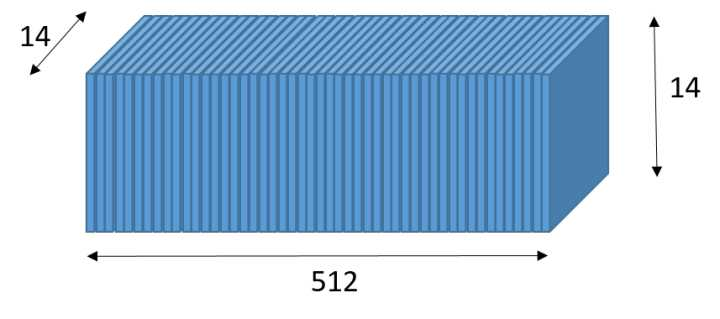

In [5]:
# 设置Gram矩阵的计算图，首先用batch_flatten将输出的feature map扁平化，
# 然后自己跟自己的转置矩阵做乘法，跟我们之前说过的过程一样。注意这里的输入是深度学习网络某一层的输出值。
def gram_matrix(x): 
    # permute_dimensions按照给定的模式重排一个张量
    # batch_flatten将一个n阶张量转变为2阶张量，其第一维度保留不变，
    # 这里的扁平化主要是保留特征图的个数，让二维的特征图变成一维(类似上图)
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    # 格拉姆矩阵
    gram = K.dot(features, K.transpose(features))
    return gram

# 设置风格loss计算方式，以风格图片和待优化的图片的某一卷积层的输入作为输入。
# 计算他们的Gram矩阵，然后计算两个Gram矩阵的差的平方，除以一个归一化值
def style_loss(style, combination): 
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return K.sum(K.square(S - C)) / (4. * (channels ** 2) * (size ** 2))

# 设置内容loss计算方式，以内容图片和待优化的图片的representation为输入，计算他们差的平方。像素级对比
def content_loss(base, combination):
    return K.sum(K.square(combination - base))

# 施加全变差正则，全变差正则化常用于图片去噪，可以使生成的图片更加平滑自然。
def total_variation_loss(x): 
    assert K.ndim(x) == 4
    a = K.square(x[:, :img_nrows-1, :img_ncols-1, :] - x[:, 1:, :img_ncols-1, :])
    b = K.square(x[:, :img_nrows-1, :img_ncols-1, :] - x[:, :img_nrows-1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))

为什么Gram矩阵能表征图像的风格呢？  
feature map是提取到的抽象特征，而Gram矩阵，就是各个feature map两两做内积，其实就是计算各个feature map的两两相关性。  
以梵高的星空举例：  
某一层中有一个滤波器专门检测尖尖的部位，另一个滤波器专门检测黑色。有一个滤波器专门检测圆形，另一个滤波器专门检测金黄色。对于梵高的星空来说，“尖尖的”和“黑色”经常一起出现，它们的相关性比较高。而“圆圆的”和“金黄色”经常一起出现，它们的相关性比较高。因此在风格转移的时候，其他的图片也会去寻找这种搭配。

In [6]:
# 读入内容和风格图，包装为Keras张量，这是一个4维张量
base_image = K.variable(preprocess_image(base_image_path)) # 内容图
style_reference_image = K.variable(preprocess_image(style_reference_image_path)) # 风格图 

# 初始化一个待优化图片的占位符，这个地方待会儿实际跑起来的时候把噪声图片或者内容图片填进来。
combination_image = K.placeholder((1, img_nrows, img_ncols, 3)) 

# 将三个张量串联到一起，形成一个形状为（3,img_nrows,img_ncols,3）的张量
input_tensor = K.concatenate([base_image, style_reference_image, combination_image], axis=0) 

In [7]:
# 载入模型
model = vgg16.VGG16(input_tensor=input_tensor, weights='imagenet', include_top=False)
print('Model loaded.')

# 这是一个字典，建立了层名称到层输出张量的映射，通过这个字典我们可以通过层的名字来获取其输出张量。
# 使用model.get_layer(layer_name).output的效果也是一样的。
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers]) 

# 初始化loss值
loss = K.variable(0.) 

# 计算内容损失取内容图像和待优化图像即可
# 这里只取了一层的输出进行对比，取多层输出效果变化不大
# layer_features就是图片在模型的block5_conv2这层的输出了，记得我们把输入做成了(3,nb_rows,nb_cols, 3)这样的张量，
# 0号位置对应内容图像的输出，1号是风格图像的，2号位置是待优化的图像的。
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :] 
# 计算内容损失
loss += content_weight * content_loss(base_image_features, combination_features) 

# 计算风格损失
# 与上面的过程类似，只是对多个层的输出作用而已，求出各个层的风格loss，相加求平均即可。
feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']

for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :]
    combination_features = layer_features[2, :, :, :]
    # 计算风格损失
    sl = style_loss(style_reference_features, combination_features)
    loss += (style_weight / len(feature_layers)) * sl 

# 求全变差正则，加入总loss中
loss += total_variation_weight * total_variation_loss(combination_image) 

58892288/58889256 [==============================] - 33s 1us/step
Model loaded.


In [8]:
# 得到loss函数关于combination_image的梯度
grads = K.gradients(loss, combination_image) 

outputs = [loss]
# 我们希望同时得到梯度和损失，所以这两个都应该是计算图的输出
# 0号位置是loss，1号位置是grads
outputs += grads
# 编译计算图。前面的代码都在规定输入输出的计算关系，到这里才将计算图编译了。
# 这条语句以后，f_outputs就是一个可用的Keras函数，给定一个输入张量，就能获得其loss值和梯度了。
# 我们这里是一次计算同时可以得到loss和grads值
f_outputs = K.function([combination_image], outputs) # 第一个参数输入，第二个参数输出

In [9]:
# 获取loss和grads
def eval_loss_and_grads(x):
    # 把输入reshape层矩阵
    x = x.reshape((1, img_nrows, img_ncols, 3))
    # 这里调用了我们刚定义的计算图
    outs = f_outputs([x])
    loss_value = outs[0]
    # outs是一个长为2的tuple，0号位置是loss，1号位置是grads。把grads扁平化
    grad_values = outs[1].flatten().astype('float64')
    return loss_value, grad_values

In [10]:
# 定义了两个方法，一个用于返回loss，一个用于返回grads
class Evaluator(object):
    def __init__(self):
        # 初始化损失值和梯度值
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        # 调用函数得到梯度值和损失值，但只返回损失值，而将梯度值保存在成员变量self.grads_values中
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        # 这个函数不用做任何计算，只需要把成员变量self.grads_values的值返回去就行了
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

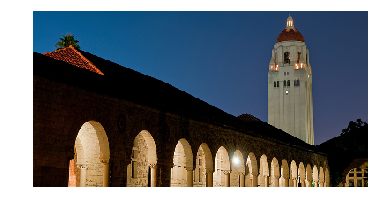

Start of iteration 0
Current loss value: 2702886100.0
Image saved as image/output/output_at_iteration_0.png
Iteration 0 completed in 23s


C:\Users\Ian\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


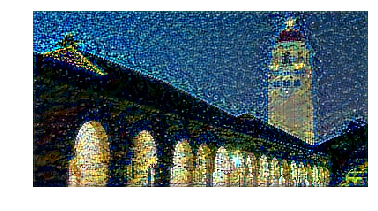

Start of iteration 1
Current loss value: 518215070.0
Image saved as image/output/output_at_iteration_1.png
Iteration 1 completed in 12s


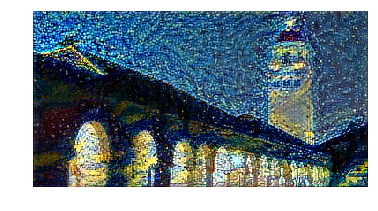

Start of iteration 2
Current loss value: 234244080.0
Image saved as image/output/output_at_iteration_2.png
Iteration 2 completed in 12s


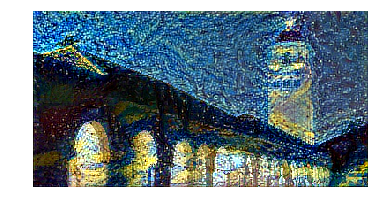

Start of iteration 3
Current loss value: 151618220.0
Image saved as image/output/output_at_iteration_3.png
Iteration 3 completed in 12s


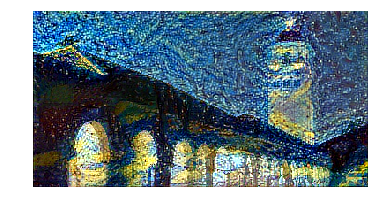

Start of iteration 4
Current loss value: 108880136.0
Image saved as image/output/output_at_iteration_4.png
Iteration 4 completed in 12s


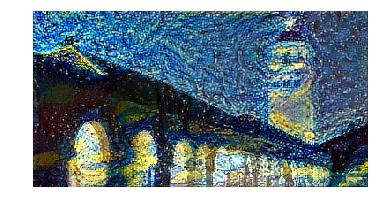

Start of iteration 5
Current loss value: 91183030.0
Image saved as image/output/output_at_iteration_5.png
Iteration 5 completed in 12s


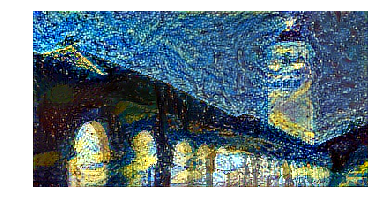

Start of iteration 6
Current loss value: 79763750.0
Image saved as image/output/output_at_iteration_6.png
Iteration 6 completed in 12s


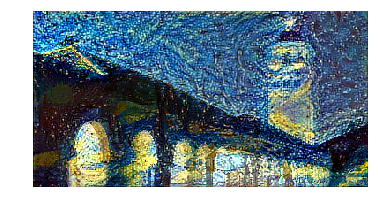

Start of iteration 7
Current loss value: 70473490.0
Image saved as image/output/output_at_iteration_7.png
Iteration 7 completed in 12s


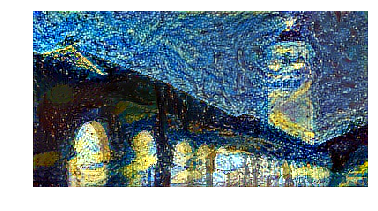

Start of iteration 8
Current loss value: 63424450.0
Image saved as image/output/output_at_iteration_8.png
Iteration 8 completed in 12s


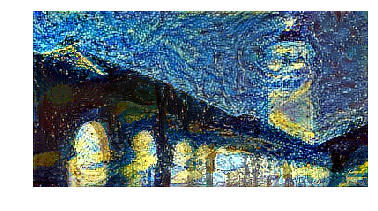

Start of iteration 9
Current loss value: 57762176.0
Image saved as image/output/output_at_iteration_9.png
Iteration 9 completed in 12s


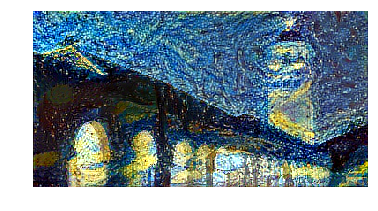

Start of iteration 10
Current loss value: 53780200.0
Image saved as image/output/output_at_iteration_10.png
Iteration 10 completed in 12s


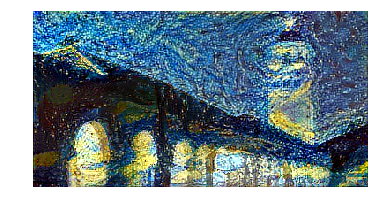

Start of iteration 11
Current loss value: 50717544.0
Image saved as image/output/output_at_iteration_11.png
Iteration 11 completed in 12s


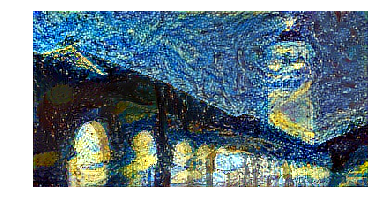

Start of iteration 12
Current loss value: 46885136.0
Image saved as image/output/output_at_iteration_12.png
Iteration 12 completed in 12s


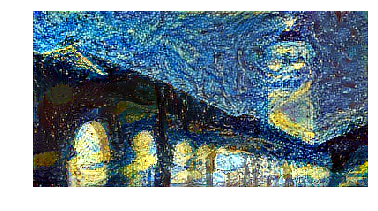

Start of iteration 13
Current loss value: 44569570.0
Image saved as image/output/output_at_iteration_13.png
Iteration 13 completed in 12s


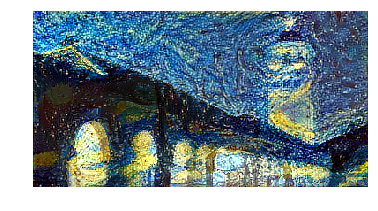

Start of iteration 14
Current loss value: 42103084.0
Image saved as image/output/output_at_iteration_14.png
Iteration 14 completed in 12s


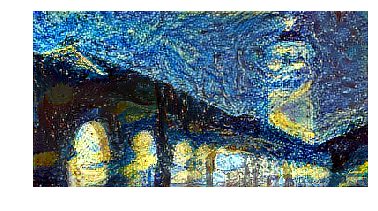

Start of iteration 15
Current loss value: 40106050.0
Image saved as image/output/output_at_iteration_15.png
Iteration 15 completed in 12s


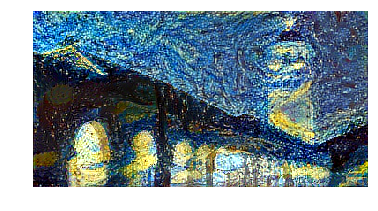

Start of iteration 16
Current loss value: 38622524.0
Image saved as image/output/output_at_iteration_16.png
Iteration 16 completed in 12s


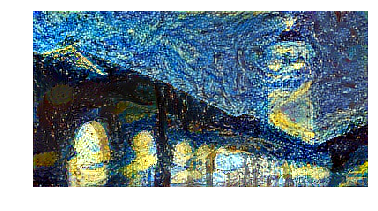

Start of iteration 17
Current loss value: 37295884.0
Image saved as image/output/output_at_iteration_17.png
Iteration 17 completed in 12s


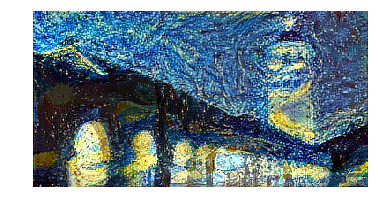

Start of iteration 18
Current loss value: 36120490.0
Image saved as image/output/output_at_iteration_18.png
Iteration 18 completed in 12s


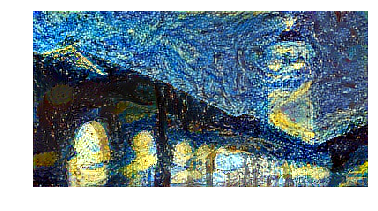

Start of iteration 19
Current loss value: 34896424.0
Image saved as image/output/output_at_iteration_19.png
Iteration 19 completed in 12s


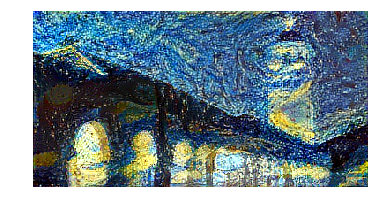

Start of iteration 20
Current loss value: 33774804.0
Image saved as image/output/output_at_iteration_20.png
Iteration 20 completed in 12s


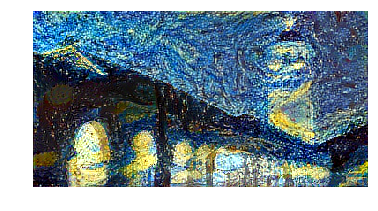

Start of iteration 21
Current loss value: 32911348.0
Image saved as image/output/output_at_iteration_21.png
Iteration 21 completed in 12s


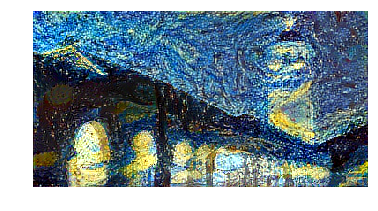

Start of iteration 22
Current loss value: 32186942.0
Image saved as image/output/output_at_iteration_22.png
Iteration 22 completed in 12s


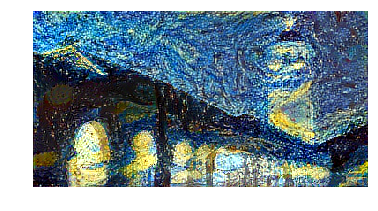

Start of iteration 23
Current loss value: 31591450.0
Image saved as image/output/output_at_iteration_23.png
Iteration 23 completed in 12s


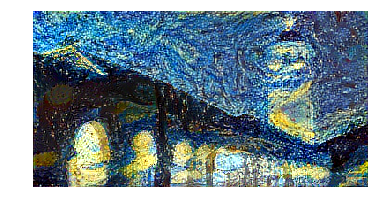

Start of iteration 24
Current loss value: 31014908.0
Image saved as image/output/output_at_iteration_24.png
Iteration 24 completed in 12s


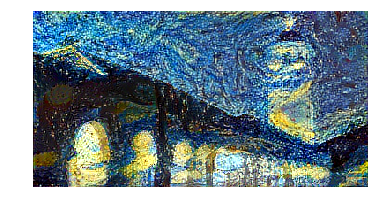

Start of iteration 25
Current loss value: 30471940.0
Image saved as image/output/output_at_iteration_25.png
Iteration 25 completed in 12s


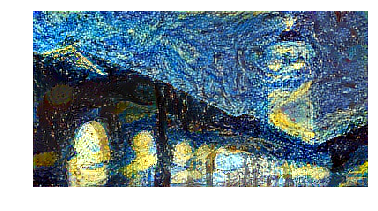

Start of iteration 26
Current loss value: 29954936.0
Image saved as image/output/output_at_iteration_26.png
Iteration 26 completed in 12s


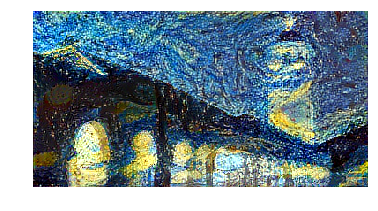

Start of iteration 27
Current loss value: 29298874.0
Image saved as image/output/output_at_iteration_27.png
Iteration 27 completed in 12s


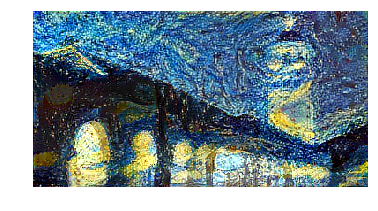

Start of iteration 28
Current loss value: 28778660.0
Image saved as image/output/output_at_iteration_28.png
Iteration 28 completed in 12s


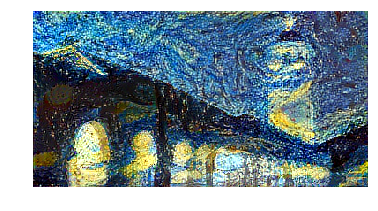

Start of iteration 29
Current loss value: 28246550.0
Image saved as image/output/output_at_iteration_29.png
Iteration 29 completed in 12s


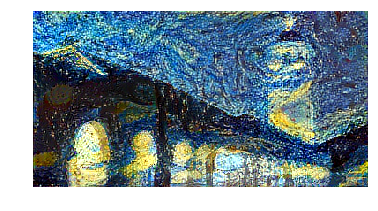

In [11]:
evaluator = Evaluator()

# 使用内容图片作为待优化图片
x = preprocess_image(base_image_path)

# 显示原始图片
img = load_img(base_image_path, target_size=(img_nrows, img_ncols)) 
plt.imshow(img)
plt.axis('off')
plt.show()

for i in range(iterations):
    
    print('Start of iteration', i)
    start_time = time.time()
    # 使用(L-BFGS)算法来最小化loss的值
    # 参数1：传入一个带返回值的函数，然后最小化返回值
    # 参数2：初始值(初始图片)
    # 参数3：传入一个带返回值的函数，返回值是梯度
    # 参数4：迭代次数
    # 返回值1：优化后的值(改变的图片)
    # 返回值2：loss值
    # 返回值3：计算过程的一些信息
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(), fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    
    # 反向操作，加上颜色均值，'BGR'->'RGB'
    img = deprocess_image(x.copy())

    # 保存每一张产生的新图片
    fname = result_prefix + '_at_iteration_%d.png' % i
    print('Image saved as', fname)
    imsave(fname, img)
    
    # 计算迭代1次花费的时间
    end_time = time.time()
    print('Iteration %d completed in %ds' % (i, end_time - start_time))
    
    # 显示图片
    plt.imshow(img)
    plt.axis('off')
    plt.show()

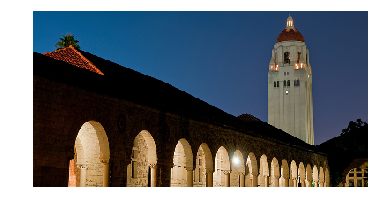

Start of iteration 0
Current loss value: 5531839500.0
Image saved as image/output/my_at_iteration_0.png
Iteration 0 completed in 13s


C:\Users\Ian\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


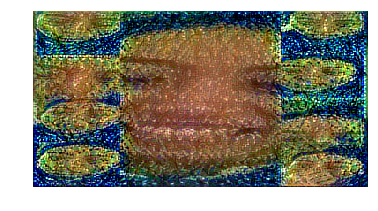

Start of iteration 1
Current loss value: 765516540.0
Image saved as image/output/my_at_iteration_1.png
Iteration 1 completed in 12s


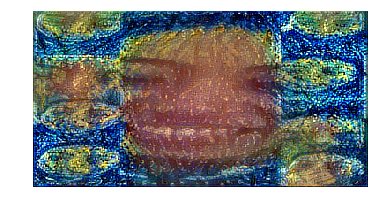

Start of iteration 2
Current loss value: 293232420.0
Image saved as image/output/my_at_iteration_2.png
Iteration 2 completed in 12s


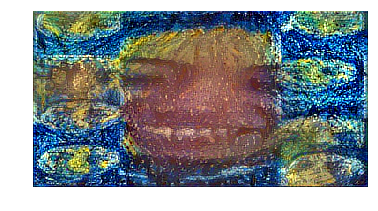

Start of iteration 3
Current loss value: 183014380.0
Image saved as image/output/my_at_iteration_3.png
Iteration 3 completed in 12s


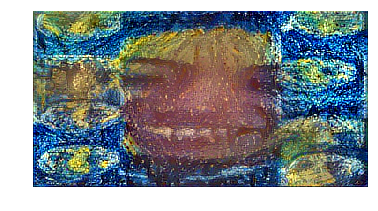

Start of iteration 4
Current loss value: 138046880.0
Image saved as image/output/my_at_iteration_4.png
Iteration 4 completed in 12s


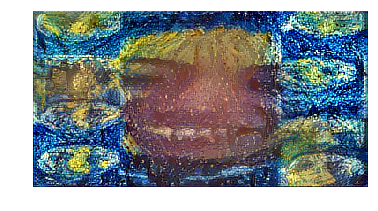

Start of iteration 5
Current loss value: 110722616.0
Image saved as image/output/my_at_iteration_5.png
Iteration 5 completed in 12s


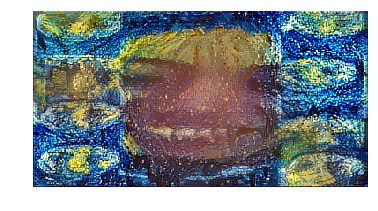

Start of iteration 6
Current loss value: 96342410.0
Image saved as image/output/my_at_iteration_6.png
Iteration 6 completed in 12s


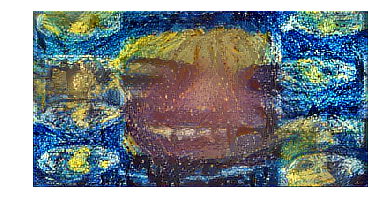

Start of iteration 7
Current loss value: 83936280.0
Image saved as image/output/my_at_iteration_7.png
Iteration 7 completed in 12s


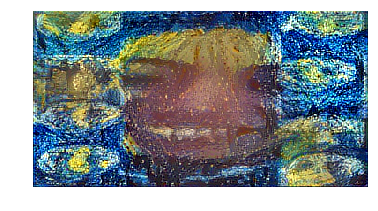

Start of iteration 8
Current loss value: 74319860.0
Image saved as image/output/my_at_iteration_8.png
Iteration 8 completed in 12s


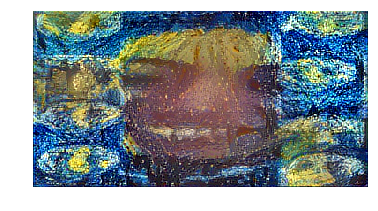

Start of iteration 9
Current loss value: 66193908.0
Image saved as image/output/my_at_iteration_9.png
Iteration 9 completed in 12s


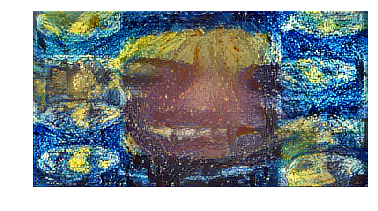

Start of iteration 10
Current loss value: 61104244.0
Image saved as image/output/my_at_iteration_10.png
Iteration 10 completed in 12s


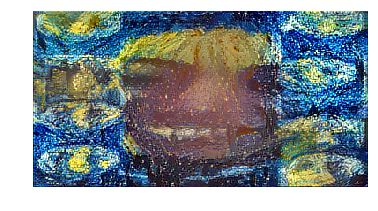

Start of iteration 11
Current loss value: 56326196.0
Image saved as image/output/my_at_iteration_11.png
Iteration 11 completed in 12s


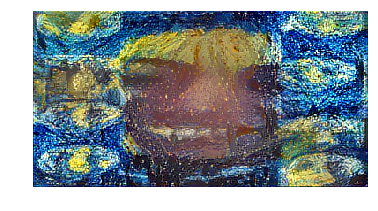

Start of iteration 12
Current loss value: 52302700.0
Image saved as image/output/my_at_iteration_12.png
Iteration 12 completed in 12s


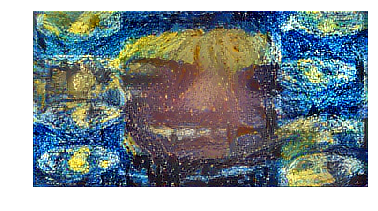

Start of iteration 13
Current loss value: 49560940.0
Image saved as image/output/my_at_iteration_13.png
Iteration 13 completed in 12s


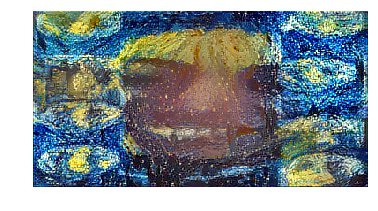

Start of iteration 14
Current loss value: 46721760.0
Image saved as image/output/my_at_iteration_14.png
Iteration 14 completed in 12s


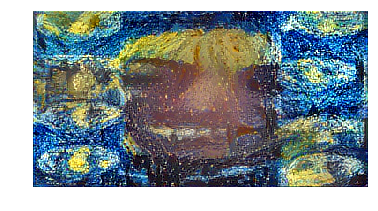

Start of iteration 15
Current loss value: 44543964.0
Image saved as image/output/my_at_iteration_15.png
Iteration 15 completed in 12s


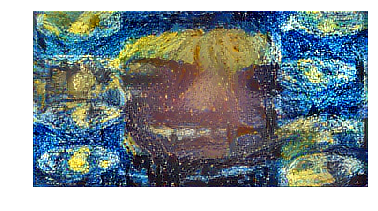

Start of iteration 16
Current loss value: 42754570.0
Image saved as image/output/my_at_iteration_16.png
Iteration 16 completed in 12s


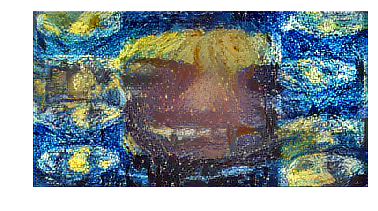

Start of iteration 17
Current loss value: 40932628.0
Image saved as image/output/my_at_iteration_17.png
Iteration 17 completed in 12s


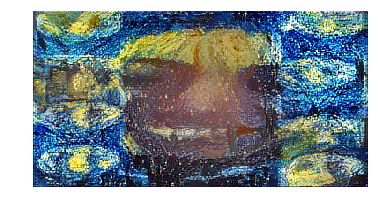

Start of iteration 18
Current loss value: 39209908.0
Image saved as image/output/my_at_iteration_18.png
Iteration 18 completed in 12s


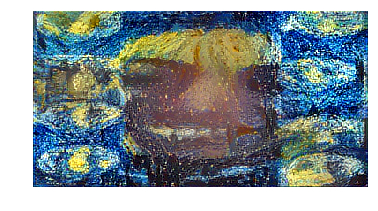

Start of iteration 19
Current loss value: 37910050.0
Image saved as image/output/my_at_iteration_19.png
Iteration 19 completed in 12s


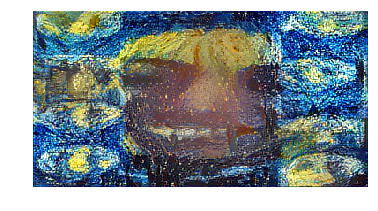

Start of iteration 20
Current loss value: 35923456.0
Image saved as image/output/my_at_iteration_20.png
Iteration 20 completed in 12s


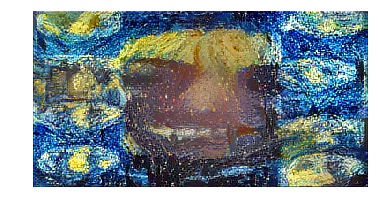

Start of iteration 21
Current loss value: 34598216.0
Image saved as image/output/my_at_iteration_21.png
Iteration 21 completed in 12s


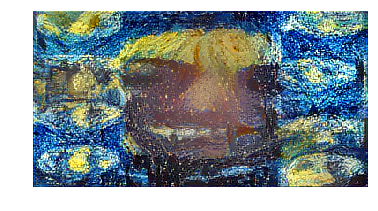

Start of iteration 22
Current loss value: 33589532.0
Image saved as image/output/my_at_iteration_22.png
Iteration 22 completed in 12s


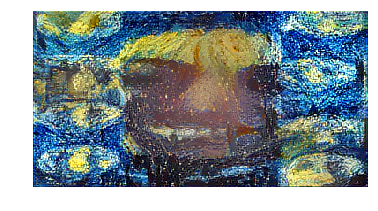

Start of iteration 23
Current loss value: 32812190.0
Image saved as image/output/my_at_iteration_23.png
Iteration 23 completed in 12s


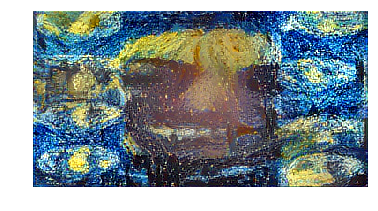

Start of iteration 24
Current loss value: 31662456.0
Image saved as image/output/my_at_iteration_24.png
Iteration 24 completed in 12s


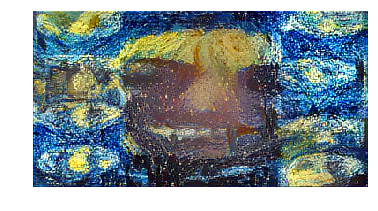

Start of iteration 25
Current loss value: 30751628.0
Image saved as image/output/my_at_iteration_25.png
Iteration 25 completed in 12s


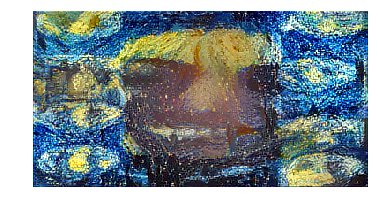

Start of iteration 26
Current loss value: 30159250.0
Image saved as image/output/my_at_iteration_26.png
Iteration 26 completed in 12s


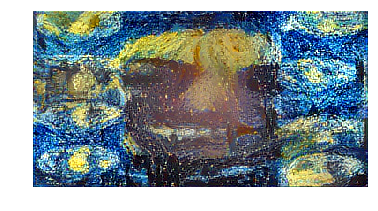

Start of iteration 27
Current loss value: 29638908.0
Image saved as image/output/my_at_iteration_27.png
Iteration 27 completed in 12s


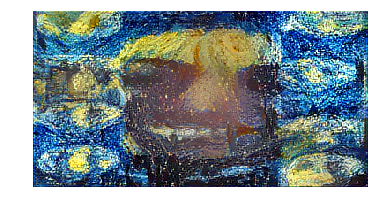

Start of iteration 28
Current loss value: 29068944.0
Image saved as image/output/my_at_iteration_28.png
Iteration 28 completed in 12s


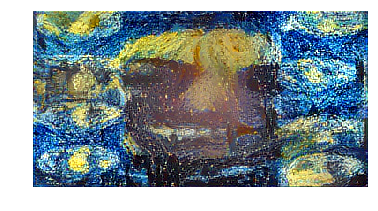

Start of iteration 29
Current loss value: 28469668.0
Image saved as image/output/my_at_iteration_29.png
Iteration 29 completed in 12s


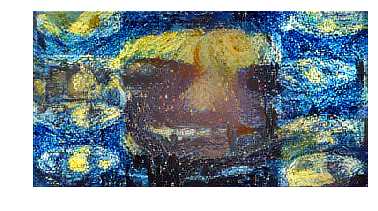

In [12]:
evaluator = Evaluator()

# 使用内容图片作为待优化图片
x = preprocess_image('image/content/1.png')
result_prefix = 'image/output/my'
# 显示原始图片
img = load_img(base_image_path, target_size=(img_nrows, img_ncols)) 
plt.imshow(img)
plt.axis('off')
plt.show()

for i in range(iterations):
    
    print('Start of iteration', i)
    start_time = time.time()
    # 使用(L-BFGS)算法来最小化loss的值
    # 参数1：传入一个带返回值的函数，然后最小化返回值
    # 参数2：初始值(初始图片)
    # 参数3：传入一个带返回值的函数，返回值是梯度
    # 参数4：迭代次数
    # 返回值1：优化后的值(改变的图片)
    # 返回值2：loss值
    # 返回值3：计算过程的一些信息
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(), fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    
    # 反向操作，加上颜色均值，'BGR'->'RGB'
    img = deprocess_image(x.copy())

    # 保存每一张产生的新图片
    fname = result_prefix + '_at_iteration_%d.png' % i
    print('Image saved as', fname)
    imsave(fname, img)
    
    # 计算迭代1次花费的时间
    end_time = time.time()
    print('Iteration %d completed in %ds' % (i, end_time - start_time))
    
    # 显示图片
    plt.imshow(img)
    plt.axis('off')
    plt.show()

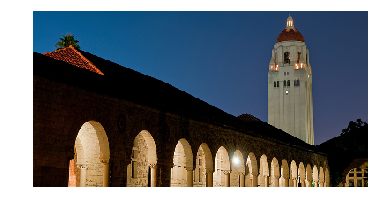

Start of iteration 0
Current loss value: 1473056300.0
Image saved as image/output/king_at_iteration_0.png
Iteration 0 completed in 12s


C:\Users\Ian\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


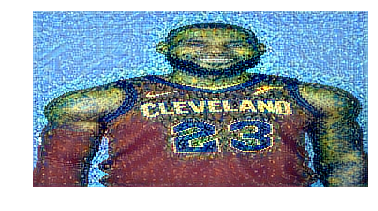

Start of iteration 1
Current loss value: 367867800.0
Image saved as image/output/king_at_iteration_1.png
Iteration 1 completed in 12s


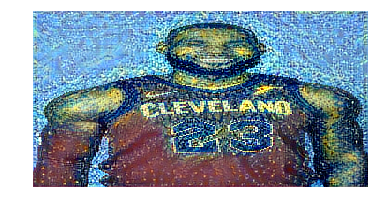

Start of iteration 2
Current loss value: 205928480.0
Image saved as image/output/king_at_iteration_2.png
Iteration 2 completed in 12s


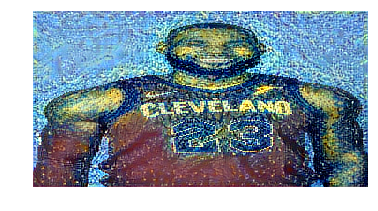

Start of iteration 3
Current loss value: 130183840.0
Image saved as image/output/king_at_iteration_3.png
Iteration 3 completed in 12s


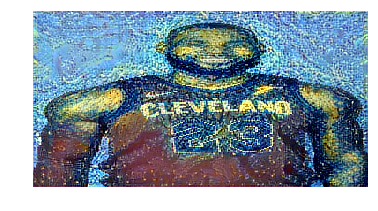

Start of iteration 4
Current loss value: 101308410.0
Image saved as image/output/king_at_iteration_4.png
Iteration 4 completed in 12s


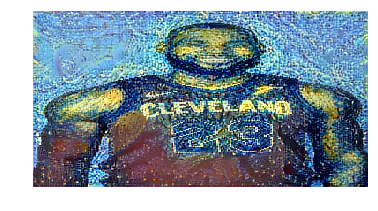

Start of iteration 5
Current loss value: 86726296.0
Image saved as image/output/king_at_iteration_5.png
Iteration 5 completed in 12s


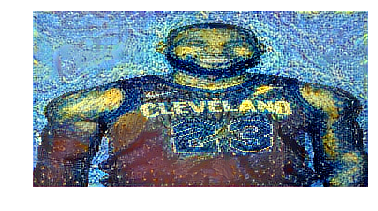

Start of iteration 6
Current loss value: 75546150.0
Image saved as image/output/king_at_iteration_6.png
Iteration 6 completed in 12s


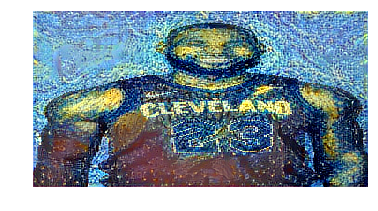

Start of iteration 7
Current loss value: 67330584.0
Image saved as image/output/king_at_iteration_7.png
Iteration 7 completed in 12s


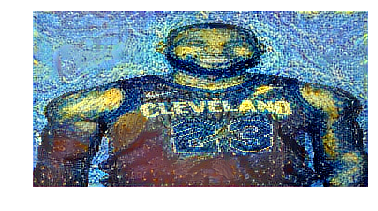

Start of iteration 8
Current loss value: 61778092.0
Image saved as image/output/king_at_iteration_8.png
Iteration 8 completed in 12s


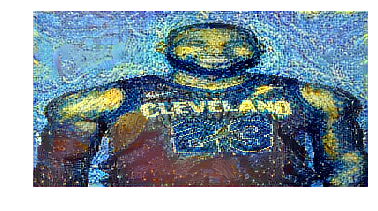

Start of iteration 9
Current loss value: 56524084.0
Image saved as image/output/king_at_iteration_9.png
Iteration 9 completed in 12s


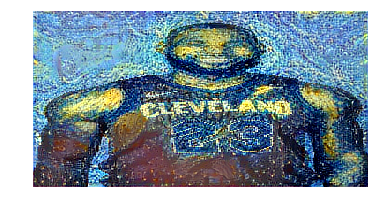

Start of iteration 10
Current loss value: 52706130.0
Image saved as image/output/king_at_iteration_10.png
Iteration 10 completed in 12s


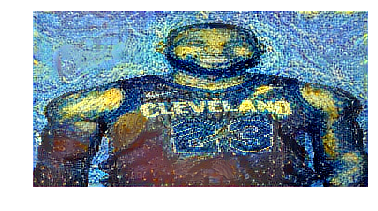

Start of iteration 11
Current loss value: 48175730.0
Image saved as image/output/king_at_iteration_11.png
Iteration 11 completed in 12s


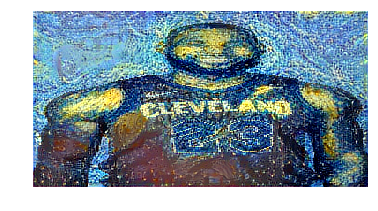

Start of iteration 12
Current loss value: 45523452.0
Image saved as image/output/king_at_iteration_12.png
Iteration 12 completed in 12s


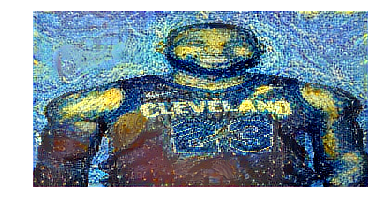

Start of iteration 13
Current loss value: 43520052.0
Image saved as image/output/king_at_iteration_13.png
Iteration 13 completed in 12s


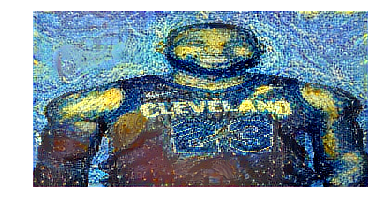

In [13]:
evaluator = Evaluator()
iterations = 14
# 使用内容图片作为待优化图片
x = preprocess_image('image/content/1.jpg')
result_prefix = 'image/output/king'
# 显示原始图片
img = load_img(base_image_path, target_size=(img_nrows, img_ncols)) 
plt.imshow(img)
plt.axis('off')
plt.show()

for i in range(iterations):
    
    print('Start of iteration', i)
    start_time = time.time()
    # 使用(L-BFGS)算法来最小化loss的值
    # 参数1：传入一个带返回值的函数，然后最小化返回值
    # 参数2：初始值(初始图片)
    # 参数3：传入一个带返回值的函数，返回值是梯度
    # 参数4：迭代次数
    # 返回值1：优化后的值(改变的图片)
    # 返回值2：loss值
    # 返回值3：计算过程的一些信息
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(), fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    
    # 反向操作，加上颜色均值，'BGR'->'RGB'
    img = deprocess_image(x.copy())

    # 保存每一张产生的新图片
    fname = result_prefix + '_at_iteration_%d.png' % i
    print('Image saved as', fname)
    imsave(fname, img)
    
    # 计算迭代1次花费的时间
    end_time = time.time()
    print('Iteration %d completed in %ds' % (i, end_time - start_time))
    
    # 显示图片
    plt.imshow(img)
    plt.axis('off')
    plt.show()

Start of iteration 0
Current loss value: 1929088900.0
Image saved as image/output/trump_at_iteration_0.png
Iteration 0 completed in 12s


C:\Users\Ian\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


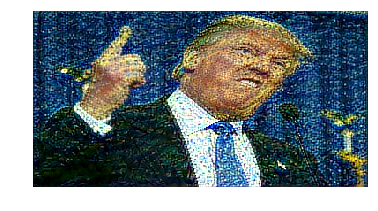

Start of iteration 1
Current loss value: 396117200.0
Image saved as image/output/trump_at_iteration_1.png
Iteration 1 completed in 12s


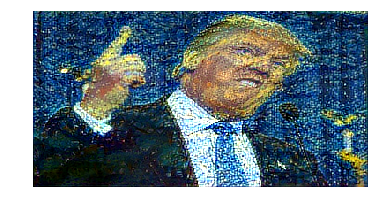

Start of iteration 2
Current loss value: 178691460.0
Image saved as image/output/trump_at_iteration_2.png
Iteration 2 completed in 12s


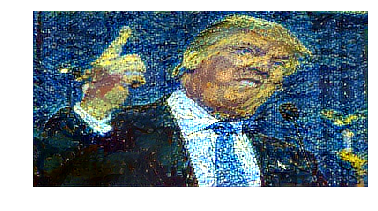

Start of iteration 3
Current loss value: 118096790.0
Image saved as image/output/trump_at_iteration_3.png
Iteration 3 completed in 12s


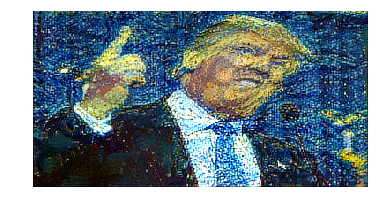

Start of iteration 4
Current loss value: 94008710.0
Image saved as image/output/trump_at_iteration_4.png
Iteration 4 completed in 12s


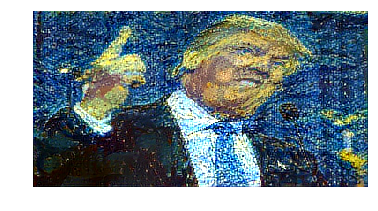

Start of iteration 5
Current loss value: 75468090.0
Image saved as image/output/trump_at_iteration_5.png
Iteration 5 completed in 12s


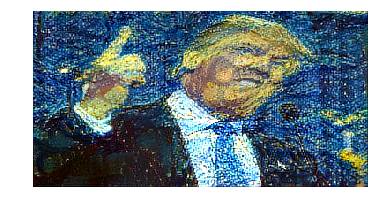

Start of iteration 6
Current loss value: 64360196.0
Image saved as image/output/trump_at_iteration_6.png
Iteration 6 completed in 12s


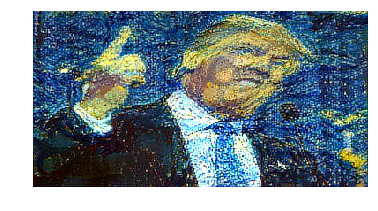

Start of iteration 7
Current loss value: 57716184.0
Image saved as image/output/trump_at_iteration_7.png
Iteration 7 completed in 12s


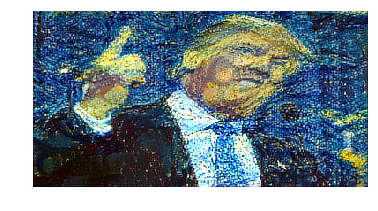

Start of iteration 8
Current loss value: 52938130.0
Image saved as image/output/trump_at_iteration_8.png
Iteration 8 completed in 12s


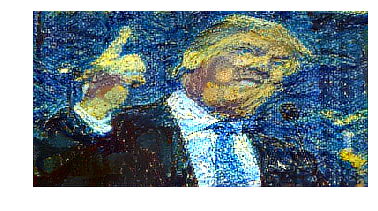

Start of iteration 9
Current loss value: 48496110.0
Image saved as image/output/trump_at_iteration_9.png
Iteration 9 completed in 12s


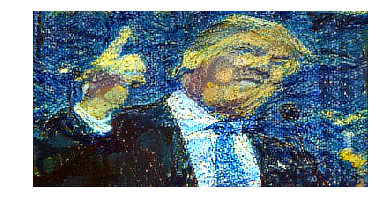

Start of iteration 10
Current loss value: 45429064.0
Image saved as image/output/trump_at_iteration_10.png
Iteration 10 completed in 12s


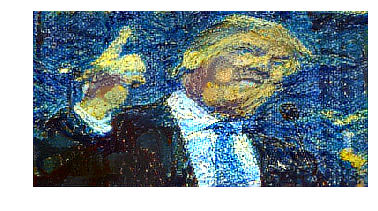

Start of iteration 11
Current loss value: 42667388.0
Image saved as image/output/trump_at_iteration_11.png
Iteration 11 completed in 12s


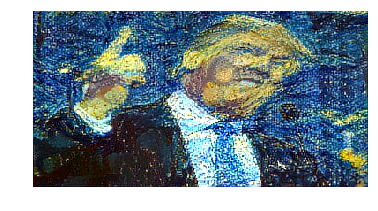

Start of iteration 12
Current loss value: 40593692.0
Image saved as image/output/trump_at_iteration_12.png
Iteration 12 completed in 12s


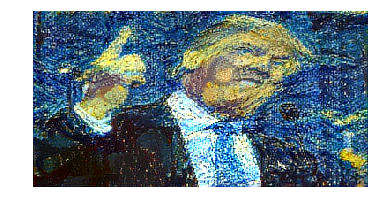

Start of iteration 13
Current loss value: 38648676.0
Image saved as image/output/trump_at_iteration_13.png
Iteration 13 completed in 12s


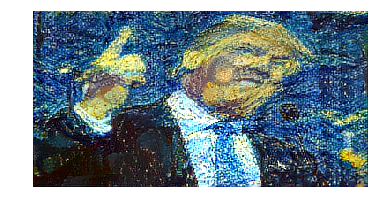

In [14]:
evaluator = Evaluator()
iterations = 14
# 使用内容图片作为待优化图片
x = preprocess_image('image/content/2.jpg')
result_prefix = 'image/output/trump'
# 显示原始图片
# img = load_img(base_image_path, target_size=(img_nrows, img_ncols)) 
# plt.imshow(img)
# plt.axis('off')
# plt.show()

for i in range(iterations):
    
    print('Start of iteration', i)
    start_time = time.time()
    # 使用(L-BFGS)算法来最小化loss的值
    # 参数1：传入一个带返回值的函数，然后最小化返回值
    # 参数2：初始值(初始图片)
    # 参数3：传入一个带返回值的函数，返回值是梯度
    # 参数4：迭代次数
    # 返回值1：优化后的值(改变的图片)
    # 返回值2：loss值
    # 返回值3：计算过程的一些信息
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(), fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    
    # 反向操作，加上颜色均值，'BGR'->'RGB'
    img = deprocess_image(x.copy())

    # 保存每一张产生的新图片
    fname = result_prefix + '_at_iteration_%d.png' % i
    print('Image saved as', fname)
    imsave(fname, img)
    
    # 计算迭代1次花费的时间
    end_time = time.time()
    print('Iteration %d completed in %ds' % (i, end_time - start_time))
    
    # 显示图片
    plt.imshow(img)
    plt.axis('off')
    plt.show()